# Anime Analysis and Recommendation

Rachael Bryant

Flatiron Capstone

Presented on March 8th at 10am

## Summary

Classifying the synopses of animes as according to the MyAnimeList dataset according to the score of the anime was the primary directive of this project. Jupyter notebok, Amazon Web Services and Google Collaboration were used to create this project. This dataset was chosen from Kaggle, scrapped in 2022 and contained descriptive attributes of the anime (type, genre, themes, source, duration, score, and rank, etc.). While exploring the data, it was discovered that comedy was the most depicted genre, TV was the most depicted type, and Toei animation is the most prolific studio. However, there was not a high correlation between these fatures according to the correlation matrix heatmap. In order to compare the highly scored anime with the highest grossing movies, the Box Office Mojo site was scrapped using Beautiful Soup and explored. While preparing the data for modeling NLK (Natural Language Toolkit) was utilized in tokenizing, lemmatization, and navigating stop words in the text. After conducting a train-test split on the data in order to properly validate the models, the data was standardized using StandardScaler and then vectorized using CountVectorizer. FreqDist from the NLK package aided in displaying the most frequent words that appear throughout the tweets (source, one, one, write, mal). Basic Logistic Regression, Support Vector Machines, Stochastic Gradient Descent, Random Forest, Naive Nayes, and K-nearest Neighbors models were tested first. Although the highest recall recorded was only .50, hypertuning was performed on Random Forest, logistic Regression and Multinomial Naive Bayes, which is known for working well with NLP data. Unsupervised K-Means was also performed, which found 9 clusters and depicted them in a visualization, as well as word2vec which utilized t-distributed stochastic neighbor embedding (t-SNE) to show the distance of the words well. The last aspect was a recommendation system that takes in a name of an anime and gives 10 examples of similar anime in terms of genre and lists their scores. Overall, the models were quite low even the highest which was the hypertuned Logistic Regression model, so I don't recommend them. I recommend going through the data to add where Nan and Null is located as well as comparing the site against the recommendation system created here. The descriptive data can used well in writing synopses as well as marketing future anime well to gain new viewership to their site.

## Overview

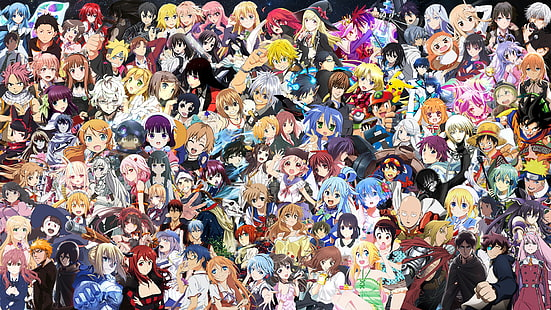

This project used Jupyter notebok, Amazon Web Services and Google Collaboration in order to create this project. The purpose of this project was to analyze the text of the synopses of the anime collected from MyAnimeList and found from Kaggle in order to predict the score of an anime in a multiclass classification problem and then a recommendation program was created to provide the best recommendation for any anime input. 

## Business Problem

<img src="Images/MyAnimeList.png" width=200 height=100>

My Anime List want to know how to write their synopses in order for anime to have higher scores from viewers. Specifically whether any aspect of the description meant for marketing influences rank or rating of an anime. They would also like to know whether their recommendation system is working well with their opinion based recommendations. 

## Data Understanding

The primary dataset was sourced from Kaggle. It was utilized from web scraping sourced by MyAnimeList.net in 2022. 13030 total data items are contained in this dataset. In detail, this dataset contains:

-  Backgrounds, such as synopsis and background.
-  Title and alternative titles, such as title, synonyms, Japanese, and English.
-  Detailed information, such as genres, themes, demographics, and status.
-  Statistics, such as score, rank, and popularity.

In [1]:
#import necessary libraries

import pandas as pd 
import numpy as np 
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

import sklearn
from sklearn.tree import DecisionTreeClassifier 
from sklearn.metrics import accuracy_score, roc_curve, auc
from sklearn import tree 
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, recall_score,precision_score,f1_score,log_loss
from sklearn.linear_model import SGDClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import roc_auc_score
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.neighbors import KNeighborsClassifier
from sklearn.datasets import make_multilabel_classification
import warnings; warnings.filterwarnings('ignore')
from sklearn import metrics
from sklearn.ensemble import RandomForestRegressor
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import LinearSVC
from sklearn.model_selection import RandomizedSearchCV

from tabulate import tabulate
import dataframe_image as dfi
from pandas.plotting import table 

import imblearn
from sklearn.datasets import make_classification
from imblearn.over_sampling import SMOTE
import wordcloud
from os import path
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import HashingVectorizer
from sklearn.naive_bayes import MultinomialNB
from nltk import FreqDist
from nltk.tokenize import word_tokenize
from nltk import pos_tag
from nltk.stem import PorterStemmer
import re
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from sklearn.model_selection import cross_validate
import nltk
import string 
from nltk.tokenize import RegexpTokenizer
from collections import defaultdict
from nltk.corpus import wordnet 
from matplotlib.ticker import MaxNLocator
from sklearn.pipeline import Pipeline
from collections import Counter
from imblearn.combine import SMOTEENN, SMOTETomek
from imblearn.pipeline import make_pipeline
from sklearn.svm import LinearSVC
from sklearn import *
from sklearn.metrics import roc_auc_score
from scikitplot.metrics import plot_roc_curve

from sklearn.calibration import CalibratedClassifierCV
import pandas as pd
import dataframe_image as dfi
from importlib.metadata import version
from sklearn.model_selection import cross_val_predict
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import plotly
import plotly.graph_objects as go
import plotly.offline as pyo
from plotly.offline import init_notebook_mode
from sklearn.cluster import SpectralClustering
import plotly.offline as pyoff
import plotly.graph_objs as go
from sklearn.pipeline import make_pipeline
from sklearn.pipeline import make_pipeline
import plotly.express as px

import nltk

from sklearn.metrics.pairwise import sigmoid_kernel

from sklearn.datasets import make_multilabel_classification


from plotly.offline import init_notebook_mode, plot, iplot
import plotly.graph_objs as go
init_notebook_mode(connected=True)

import requests
from bs4 import BeautifulSoup

from sklearn.datasets import load_digits
from sklearn.decomposition import PCA

from surprise import Reader
import surprise
import os
import pandas as pd
import numpy as np
from scipy.stats import randint


from io import StringIO
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_selection import chi2
from IPython.display import display
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from scipy.sparse import csc_matrix
from scipy.sparse.linalg import svds
import operator as op
from surprise.model_selection import train_test_split
from surprise.model_selection import GridSearchCV
from surprise.model_selection import cross_validate
from surprise.prediction_algorithms import KNNWithMeans, KNNBasic, KNNBaseline
from surprise.prediction_algorithms import knns
from surprise.prediction_algorithms import SVD
from surprise.similarities import cosine, msd, pearson
from surprise import accuracy
from surprise import Reader
from surprise import Dataset

from sklearn.decomposition import IncrementalPCA    
from sklearn.manifold import TSNE                   
import numpy as np  


from skmultilearn.model_selection import iterative_train_test_split

import nltk

from nltk.corpus import abc

from sklearn.naive_bayes import GaussianNB,MultinomialNB
from sklearn.metrics import accuracy_score,hamming_loss
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from skmultilearn.problem_transform import BinaryRelevance
from skmultilearn.problem_transform import ClassifierChain
from skmultilearn.problem_transform import LabelPowerset

import io
import re
import string
import tqdm


import gensim
from gensim.models import Word2Vec
from gensim import models

from sklearn.cluster import KMeans

import python_utils 

import utils


### Primary Dataset: MyAnimeList EDA

The MyAnimeList csv is loaded below using pandas read_csv. The null values of each category are listed to understand whether this dataset is robust enough to further analyze. Episodes, Demographics, Duration_Minutes, Score, Scored_Users, and Ranked contain null values. They would cause issues when modeling later on, so these null values are dropped from the dataset. Just to double check that these values were dropped, the null values of each category are listed again, all are 0. To make sure there are still enough values to analyze, the total number of records is listed at the end and it is suitable at 13030.

In [2]:
#load data from csv file
myanimelist = pd.read_csv('Anime_2.csv', encoding= 'unicode_escape')
print(myanimelist.isnull().sum())
myanimelist.dropna(inplace=True)
print(myanimelist.head(5))
print(myanimelist.isnull().sum())
print(f"Total number of records: {len(myanimelist)}")

ID                     0
Title                  0
Synonyms               0
Japanese               0
English                0
Synopsis               0
Type                   0
Episodes             547
Status                 0
Start_Aired            0
End_Aired              0
Premiered              0
Broadcast              0
Producers              0
Licensors              0
Studios                0
Source                 0
Genres                 0
Themes                 0
Demographics           0
Duration_Minutes     599
Rating                 0
Score               6898
Scored_Users        6898
Ranked              1924
Popularity             0
Members                0
Favorites              0
dtype: int64
      ID                             Title  \
0  16498                Shingeki no Kyojin   
1   1535                        Death Note   
2   5114  Fullmetal Alchemist: Brotherhood   
3  30276                     One Punch Man   
4  11757                  Sword Art Online   

          

The entire dataset is better described below in a table which describes the count, unique values, frequency and other descriptors of each column.  

In [3]:
myanimelist.describe(include = 'all')


,ID,Title,Synonyms,Japanese,English,Synopsis,Type,Episodes,Status,Start_Aired,...,Themes,Demographics,Duration_Minutes,Rating,Score,Scored_Users,Ranked,Popularity,Members,Favorites
count,13030.000000,13030,13030,13030,13030,13030,13030,13030.000000,13030,13030,...,13030,13030,13030.000000,13030,13030.000000,13030.000000,13030.000000,13030.000000,1.303000e+04,13030.000000
unique,NaN,13030,8188,12332,6693,12588,7,NaN,2,6315,...,685,10,NaN,6,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,Shingeki no Kyojin,Unknown,Unknown,Unknown,Unknown,TV,NaN,Finished Airing,2008,...,Unknown,Unknown,NaN,PG-13 - Teens 13 or older,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,1,4607,23,6215,269,4237,NaN,12960,30,...,4560,8677,NaN,6409,NaN,NaN,NaN,NaN,NaN,NaN
mean,20980.652187,NaN,NaN,NaN,NaN,NaN,NaN,12.590560,NaN,NaN,...,NaN,NaN,25.967229,NaN,6.459653,29206.640215,65573.693016,7587.679739,6.283918e+04,736.706216
std,16081.671520,NaN,NaN,NaN,NaN,NaN,NaN,52.390039,NaN,NaN,...,NaN,NaN,26.263119,NaN,0.924109,89361.263385,37873.954911,4740.249477,1.963611e+05,5423.097698
min,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,...,NaN,NaN,1.000000,NaN,1.841000,101.000000,12.000000,1.000000,1.720000e+02,0.000000
25%,4760.250000,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,...,NaN,NaN,6.000000,NaN,5.831000,377.000000,32784.500000,3361.500000,1.126250e+03,1.000000
50%,19646.000000,NaN,NaN,NaN,NaN,NaN,NaN,2.000000,NaN,NaN,...,NaN,NaN,23.000000,NaN,6.471000,1942.000000,65547.000000,7415.000000,5.224000e+03,7.000000
75%,35978.750000,NaN,NaN,NaN,NaN,NaN,NaN,12.000000,NaN,NaN,...,NaN,NaN,26.000000,NaN,7.141000,14279.250000,98379.500000,11597.750000,3.397125e+04,70.000000


The head of MyAnimeList below shows that the Japanese names did not show up well and that column can't be used. 

In [4]:
myanimelist.head()

,ID,Title,Synonyms,Japanese,English,Synopsis,Type,Episodes,Status,Start_Aired,...,Themes,Demographics,Duration_Minutes,Rating,Score,Scored_Users,Ranked,Popularity,Members,Favorites
0,16498,Shingeki no Kyojin,"AoT, SnK",é²æã®å·¨äºº,Attack on Titan,"Centuries ago, mankind was slaughtered to near...",TV,25.0,Finished Airing,"Apr 7, 2013",...,"Gore, Military, Survival",Shounen,24.0,R - 17+ (violence & profanity),8.531,519803.0,1002.0,1,3524109,155695
1,1535,Death Note,DN,ãã¹ãã¼ã,Death Note,"Brutal murders, petty thefts, and senseless vi...",TV,37.0,Finished Airing,"Oct 4, 2006",...,Psychological,Shounen,23.0,R - 17+ (violence & profanity),8.621,485487.0,732.0,2,3504535,159701
2,5114,Fullmetal Alchemist: Brotherhood,"Hagane no Renkinjutsushi Fullmetal Alchemist, ...",é¼ã®é¬éè¡å¸« FULLMETAL ALCHEMIST,Fullmetal Alchemist Brotherhood,After a horrific alchemy experiment goes wrong...,TV,64.0,Finished Airing,"Apr 5, 2009",...,Military,Shounen,24.0,R - 17+ (violence & profanity),9.131,900398.0,12.0,3,2978455,207772
3,30276,One Punch Man,"One Punch-Man, One-Punch Man, OPM",ã¯ã³ãã³ãã³,One Punch Man,The seemingly unimpressive Saitama has a rathe...,TV,12.0,Finished Airing,"Oct 5, 2015",...,"Parody, Super Power",Seinen,24.0,R - 17+ (violence & profanity),8.511,19066.0,1112.0,4,2879907,59651
4,11757,Sword Art Online,"S.A.O, SAO",ã½ã¼ãã¢ã¼ãã»ãªã³ã©ã¤ã³,Sword Art Online,Ever since the release of the innovative Nerve...,TV,25.0,Finished Airing,"Jul 8, 2012",...,"Love Polygon, Video Game",Unknown,23.0,PG-13 - Teens 13 or older,7.201,990254.0,29562.0,5,2813565,64997


In order to better understand the data when plotting and analyzing, the names of the columns of interest are changed. I added 'MAL' to the beginning of a few to differentiate from another dataset.

In [5]:
myanimelist = myanimelist.rename({'Title': 'MAL_Title','Themes': 'MAL_Themes', 'Genres': 'MAL_Genres', 'Score': 'MAL_Score', 'Rating': 'MAL_Rating', 'Members': 'MAL_Members', 'Popularity': 'MAL_Popularity'}, axis = 1, inplace = False)
myanimelist.columns

Index(['ID', 'MAL_Title', 'Synonyms', 'Japanese', 'English', 'Synopsis',
       'Type', 'Episodes', 'Status', 'Start_Aired', 'End_Aired', 'Premiered',
       'Broadcast', 'Producers', 'Licensors', 'Studios', 'Source',
       'MAL_Genres', 'MAL_Themes', 'Demographics', 'Duration_Minutes',
       'MAL_Rating', 'MAL_Score', 'Scored_Users', 'Ranked', 'MAL_Popularity',
       'MAL_Members', 'Favorites'],
      dtype='object')

13030 unique titles are in this data. That's enough to do substantial EDA and analysis. 

### EDA Type of anime in MyAnimeList

This section will explore this dataset to better understand the patterns in the type of anime.
There are 7 types of anime: 

-  TV
- Movie
- Special
- OVA : 'original video animation', anime films and series meant for home video release, not created for TV or theater.
- ONA : 'original net animation', anime films and series released directly to the internet, not created for TV or theater.
- Music : short, few minute anime created for musical release
- Unknown (only 1 value)



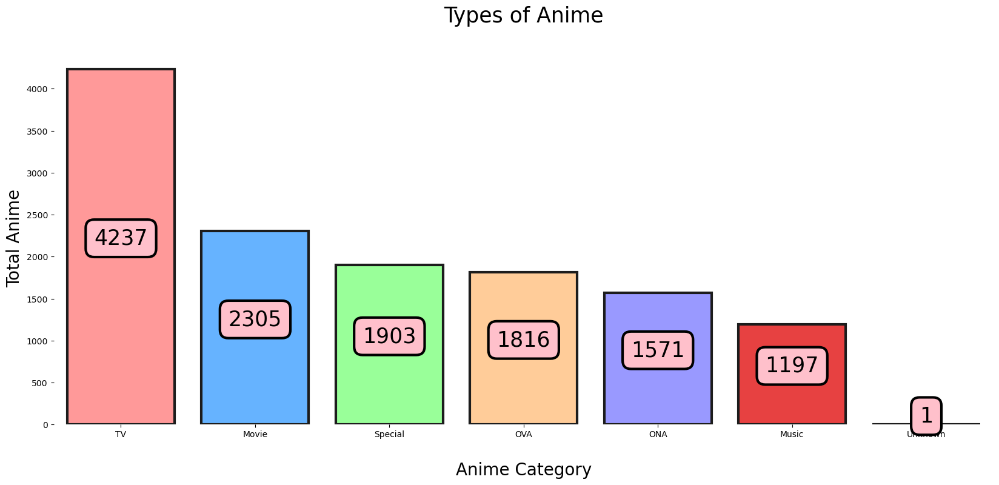

In [6]:
#visualization of how many values are in each type of anime

plt.subplots(figsize = (20,8))
palette= ['#ff9999','#66b3ff','#99ff99','#ffcc99', '#9999FF', '#E74141']
p = sns.countplot(x = myanimelist["Type"], order = myanimelist["Type"].value_counts().index, palette = palette, saturation = 1,  edgecolor = "#1c1c1c", linewidth = 3)
p.axes.set_title("Types of Anime\n" ,fontsize = 25)
plt.ylabel("Total Anime" ,fontsize = 20)
plt.xlabel("\nAnime Category" ,fontsize = 20)
plt.xticks(rotation = 0)
for container in p.containers:
    p.bar_label(container,label_type = "center",padding = 10,size = 25, color = "black", rotation = 0,
    bbox={"boxstyle": "round", "pad": 0.4, "facecolor": "pink", "edgecolor": "black", "linewidth": 3, "alpha":1})
sns.despine(left = True, bottom = True)
plt.show()

Plotly express is utilizied to depict the percentages of the types of anime below as an additional form of understanidng this data in the form of a pie chart. 

In [7]:
#creating a pie chart of anime type
type_list = list(myanimelist["Type"].unique())

type_values = []

for i in range(len(myanimelist["Type"].unique())) :

    type_values.append(myanimelist["Type"].value_counts().iloc[i])
    
fig = px.pie(values=type_values,
             names=myanimelist["Type"].unique(),
)

fig.update_traces(marker=dict(colors=palette),
                  hole = .3,
                  textposition='inside',
                  textinfo='percent+label'
)

fig.update_layout(
    annotations=[dict(text='Type', x=0.5, y=0.5, font_size=24, showarrow=False)],
    hoverlabel=dict(
        bgcolor="#e6ccff",
        font_size=14
    ),
    legend=dict(
        yanchor="top",
        y=0.90,
        xanchor="left",
        x=0.80
    ),
    font=dict(
        color = "purple"
    )
)
fig.show()

The top 10 scored anime of each type are depicted below. A few popular franchises stand out, such as Gintama, which is in the top 10 of every category but ONA. Violet Evergarden and Hunter X Hunter are also well represented. Specials are also scored lower than every other category. 

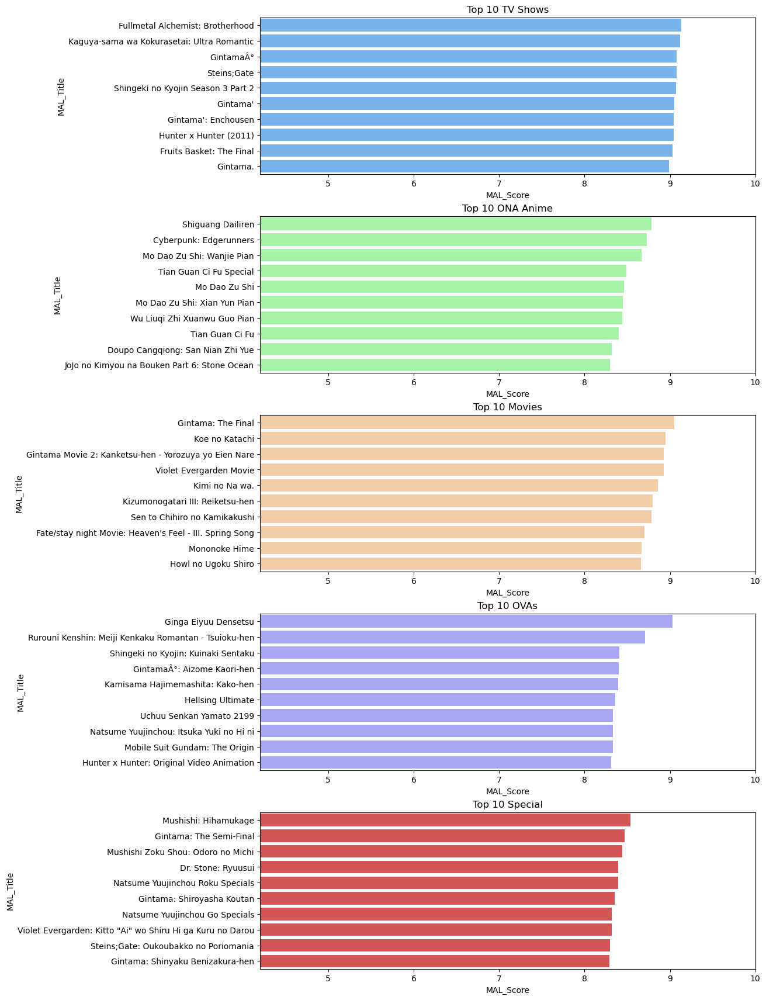

In [8]:
#visualization of the anime types as separated by type and ordered by score

tv_shows = myanimelist[myanimelist["Type"] == "TV"]
top_10_tv_shows = tv_shows.sort_values(by='MAL_Score', ascending = False).head(10)
ona_anime = myanimelist[myanimelist["Type"] == "ONA"]
top_10_ona_anime = ona_anime.sort_values(by='MAL_Score', ascending = False).head(10)
movies = myanimelist[myanimelist["Type"] == "Movie"]
top_10_movies = movies.sort_values(by='MAL_Score', ascending = False).head(10)
ova = myanimelist[myanimelist["Type"] == "OVA"]
top_10_ova = ova.sort_values(by='MAL_Score', ascending = False).head(10)
special = myanimelist[myanimelist["Type"] == "Special"]
top_10_special = special.sort_values(by='MAL_Score', ascending = False).head(10)
fig, axes = plt.subplots(5, 1, figsize=(13, 17), constrained_layout = True)

tv_plot = sns.barplot(ax=axes[0], y=top_10_tv_shows["MAL_Title"], x=top_10_tv_shows["MAL_Score"], color = palette[1])
axes[0].set_title("Top 10 TV Shows")

ona_plot = sns.barplot(ax=axes[1], y=top_10_ona_anime["MAL_Title"], x=top_10_ona_anime["MAL_Score"], color = palette[2])
axes[1].set_title("Top 10 ONA Anime")

movies_plot = sns.barplot(ax=axes[2], y=top_10_movies["MAL_Title"], x=top_10_movies["MAL_Score"], color = palette[3])
axes[2].set_title("Top 10 Movies")

ova_plot = sns.barplot(ax=axes[3], y=top_10_ova["MAL_Title"], x=top_10_ova["MAL_Score"], color = palette[4])
axes[3].set_title("Top 10 OVAs")

special_plot = sns.barplot(ax=axes[4], y=top_10_special["MAL_Title"], x=top_10_special["MAL_Score"], color = palette[5])
axes[4].set_title("Top 10 Special")

tv_plot.set(xlim=(4.2, 10)) 
ona_plot.set(xlim=(4.2, 10))
movies_plot.set(xlim=(4.2, 10))
ova_plot.set(xlim=(4.2, 10))
special_plot.set(xlim=(4.2,10))
plt.show()

The Plotly visualization below depicted the type of anime distributed by the score and popularity. TV anime are the highest scored and most popular while music is not highly scored and not as popular. Popularity is organized in which 1 = most popular.

In [9]:
fig = px.scatter(myanimelist,
y="MAL_Score",
x='MAL_Popularity',
color = "Type",
color_discrete_sequence = palette,
hover_data = ["MAL_Title"]
)
fig.update_layout(
hoverlabel=dict(
bgcolor="#e6ccff",
font_size=14
),
font=dict(
color = "Purple"
)
)
fig.show()

Plotly express is utilized below to showcase the type of anime in comparison to the score and now many members that anime has. TV anime have the most members, some movies have a large member following as well, but most Music anime do not have members.

In [10]:
fig = px.scatter(myanimelist,
y="MAL_Score",
x='MAL_Members',
color = "Type",
color_discrete_sequence = palette,
hover_data = ["MAL_Title"]
)
fig.update_layout(
hoverlabel=dict(
bgcolor="#e6ccff",
font_size=14
),
font=dict(
color = "Purple"
)
)
fig.show()


The distribution of the anime scores are shown below using plotly graph objects for visualization. Most anime are rated about 6.5 and it is a good shape of a bell curve overall.

In [11]:
data = myanimelist['MAL_Score'].value_counts().sort_index(ascending=False)
trace = go.Bar(x = data.index,
               text = ['{:.1f} %'.format(val) for val in (data.values / myanimelist.shape[0] * 100)],
               textposition = 'auto',
               textfont = dict(color = '#66b3ff'),
               y = data.values,
              )
layout = dict(title = 'Distribution Of {} Anime Scores'.format(myanimelist.shape[0]),
              xaxis = dict(title = 'Rating'),
              yaxis = dict(title = 'Count'))
fig = go.Figure(data=[trace], layout=layout)
iplot(fig)

### EDA Studios in MyAnimeList

This section will explore this dataset to better understand the patterns in the Studio category of anime. There are 1114 anime studios in this dataset. The studio creates the animation and usually they have specific characteristics they are known for. The studio with the most anime listed is Toei animation. This could be due to it's long history as well as many populart franchises. The number of studios as well as the top 20 with the most anime in the dataset are depicted below. 



In [12]:
#number of users
print("Number of studios:", myanimelist.Studios.nunique())
print(myanimelist['Studios'].value_counts()[0:20].sort_values())
studios = myanimelist['Studios'][0:20].sort_values()
# myanimelist = myanimelist[myanimelist['Studios'].str.contains("Unknown")==False]
# print(myanimelist['Studios'].value_counts()[0:20].sort_values())

Number of studios: 1114
Kyoto Animation          111
Xebec                    117
Shaft                    119
Gonzo                    119
AIC                      124
Tatsunoko Production     130
Bones                    136
Nippon Animation         154
Shin-Ei Animation        158
OLM                      207
A-1 Pictures             207
Pierrot                  228
TMS Entertainment        247
Production I.G           247
Studio Deen              262
Madhouse                 318
J.C.Staff                347
Sunrise                  491
Toei Animation           651
Unknown                 3030
Name: Studios, dtype: int64


The visualization below depicts the top 15 studios with the greatest number of animes in the dataset. Toei animation has the highest number of anime.

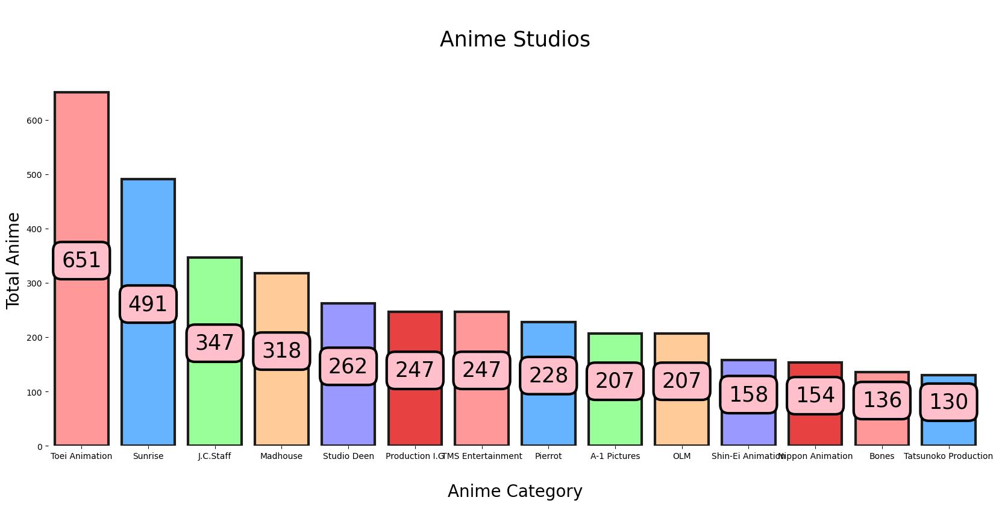

In [13]:
#visualization of how many values are in each type of anime

plt.subplots(figsize = (20,8))
palette= ['#ff9999','#66b3ff','#99ff99','#ffcc99', '#9999FF', '#E74141']
p = sns.countplot(x = myanimelist["Studios"], order = myanimelist["Studios"].value_counts()[1:15].index, palette = palette, saturation = 1,  edgecolor = "#1c1c1c", linewidth = 3)
p.axes.set_title("\nAnime Studios\n" ,fontsize = 25)
plt.ylabel("Total Anime" ,fontsize = 20)
plt.xlabel("\nAnime Category" ,fontsize = 20)
plt.xticks(rotation = 0)
for container in p.containers:
    p.bar_label(container,label_type = "center",padding = 10,size = 25, color = "black", rotation = 0,
    bbox={"boxstyle": "round", "pad": 0.4, "facecolor": "pink", "edgecolor": "black", "linewidth": 3, "alpha":1})
sns.despine(left = True, bottom = True)
plt.show()

Plotly express is utilizied to depict the percentages of the studios that create anime below as an additional form of understanidng this data in the form of a pie chart.

In [14]:
#creating a pie chart of anime type
type_list = list(studios.unique())

type_values = []

for i in range(len(studios.unique())) :

    type_values.append(studios.value_counts().iloc[i])
    
fig = px.pie(values=type_values,
             names=studios.unique(),
)

fig.update_traces(marker=dict(colors=palette),
                  hole = .3,
                  textposition='inside',
                  textinfo='percent+label'
)

fig.update_layout(
    annotations=[dict(text='Studio', x=0.5, y=0.5, font_size=24, showarrow=False)],
    hoverlabel=dict(
        bgcolor="#e6ccff",
        font_size=14
    ),
    legend=dict(
        yanchor="top",
        y=0.90,
        xanchor="left",
        x=0.80
    ),
    font=dict(
        color = "purple"
    )
)
fig.show()

In [15]:
general = myanimelist.sort_values(by='MAL_Score', ascending = False)
top_50_rated = myanimelist.head(50)
top_20_rated = myanimelist.head(20)

fig = px.bar(top_20_rated,
             y="Studios",
             x="MAL_Score",
             # orientation='h',
             height=600,
             labels={
                     "Name" : "Anime"
                    },
             color = "Type",
             color_discrete_sequence=palette,
             orientation='h'
            )
fig.update_traces(hovertemplate ='%{y}' + " : " + "%{x}", selector=dict(type="bar"))

fig.update_layout(
    title = "Top Rated Studios & Their Type",
    yaxis_title = "Anime",
    xaxis_range=[5,10],
    yaxis={'categoryorder':'total ascending'},
    hoverlabel=dict(
        bgcolor="#e6ccff",
        font_size=14
    ),
    legend=dict(
        yanchor="top",
        y=0.50,
        xanchor="left",
        x=0.80,
        bgcolor="#e6ccff",
        bordercolor="purple",
        borderwidth=1
    ),
    font=dict(
        color = "Purple"
    )
)
fig.show()

The visualization below depicts the types of anime each studios creates compared to the score they recieve by fans.

In [16]:
fig = px.scatter(myanimelist,
y="Studios",
x='MAL_Score',
color = "Type",
color_discrete_sequence = palette,
hover_data = ["MAL_Title"]
)
fig.update_layout(
hoverlabel=dict(
bgcolor="#e6ccff",
font_size=14
),
font=dict(
color = "Purple"
)
)
fig.show()

### EDA Demographics in MyAnimeList

This section will explore this dataset to better understand the patterns in the demographic of anime. There are 10 types of demographics in this dataset, but 2 have only 1 item each and 1 is Unknown, so those will be dropped. The 5 main demographics:

- Shounen: Created for boys younger than 18, typically action and adventure oriented
- Kids : Created for young children, usually are moralistic, often educating children about staying in the right path in life
- Seinen : Created for men over 18, mature topics of violence and/or psychological nature
- Shoujo : Created for girls younger than 18, typically coming of age and romance oriented
- Josei : Created for women over 18, mature topics of relationships and work life

The superfluous demographic categories are dropped below, leaving 5 categories of demographics.

In [17]:
#number of users
print("Number of demographics:", myanimelist.Demographics.nunique())
print(myanimelist['Demographics'].value_counts()[1:20].sort_values())

# myanimelist = myanimelist[myanimelist['Demographics'].str.contains("Unknown")==False]
# myanimelist = myanimelist[myanimelist['Demographics'].str.contains("Josei, Shoujo")==False]
# myanimelist = myanimelist[myanimelist['Demographics'].str.contains("Kids, Seinen")==False]
# myanimelist = myanimelist[myanimelist['Demographics'].str.contains("Kids, Shoujo")==False]
# myanimelist = myanimelist[myanimelist['Demographics'].str.contains("Kids, Shounen")==False]
# print("Number of demographics:", myanimelist.Demographics.nunique())
# print(myanimelist['Demographics'].value_counts()[0:20].sort_values())


Number of demographics: 10
Josei, Shoujo       1
Kids, Seinen        1
Kids, Shoujo       31
Kids, Shounen      61
Josei              90
Shoujo            626
Seinen            797
Kids              932
Shounen          1814
Name: Demographics, dtype: int64


Shounen has by far the greatest amount of anime with Josei the least. The majority of anime fans are younger and like action oriented anime. 

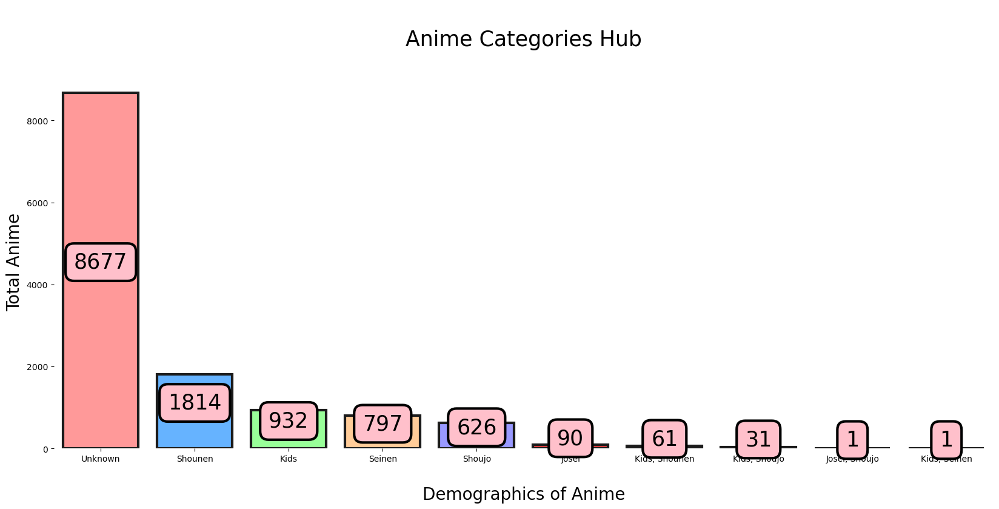

In [18]:
#visualization of how many values are in each type of anime

plt.subplots(figsize = (20,8))
palette= ['#ff9999','#66b3ff','#99ff99','#ffcc99', '#9999FF', '#E74141']
p = sns.countplot(x = myanimelist["Demographics"], order = myanimelist["Demographics"].value_counts()[0:15].index, palette = palette, saturation = 1,  edgecolor = "#1c1c1c", linewidth = 3)
p.axes.set_title("\nAnime Categories Hub\n" ,fontsize = 25)
plt.ylabel("Total Anime" ,fontsize = 20)
plt.xlabel("\nDemographics of Anime" ,fontsize = 20)
plt.xticks(rotation = 0)
for container in p.containers:
    p.bar_label(container,label_type = "center",padding = 10,size = 25, color = "black", rotation = 0,
    bbox={"boxstyle": "round", "pad": 0.4, "facecolor": "pink", "edgecolor": "black", "linewidth": 3, "alpha":1})
sns.despine(left = True, bottom = True)
plt.show()

Plotly express is utilizied to depict the percentages of the demographics that create anime below as an additional form of understanidng this data in the form of a pie chart.

In [19]:
#creating a pie chart of anime type
type_list = list(myanimelist["Demographics"].unique())

type_values = []

for i in range(len(myanimelist["Demographics"].unique())) :

    type_values.append(myanimelist["Demographics"].value_counts().iloc[i])
    
fig = px.pie(values=type_values,
             names=myanimelist["Demographics"].unique(),
)

fig.update_traces(marker=dict(colors=palette),
                  hole = .3,
                  textposition='inside',
                  textinfo='percent+label'
)

fig.update_layout(
    annotations=[dict(text='Demographic', x=0.5, y=0.5, font_size=24, showarrow=False)],
    hoverlabel=dict(
        bgcolor="#e6ccff",
        font_size=14
    ),
    legend=dict(
        yanchor="top",
        y=0.90,
        xanchor="left",
        x=0.80
    ),
    font=dict(
        color = "purple"
    )
)
fig.show()

The score and type of anime is similar amongst the demographics.

In [20]:
fig = px.scatter(myanimelist,
y="Demographics",
x='MAL_Score',
color = "Type",
color_discrete_sequence = palette,
hover_data = ["MAL_Title"]
)
fig.update_layout(
hoverlabel=dict(
bgcolor="#e6ccff",
font_size=14
),
font=dict(
color = "Purple"
)
)
fig.show()

### EDA Theme of anime in MyAnimeList

In [21]:
#number of users
print("Number of MAL_Themes:", myanimelist.MAL_Themes.nunique())
print(myanimelist['MAL_Themes'].value_counts()[1:20].sort_values())


print("Number of Themes:", myanimelist.Demographics.nunique())
print(myanimelist['MAL_Themes'].value_counts()[0:20].sort_values())
themes = myanimelist['MAL_Themes'][0:20].sort_values()


Number of MAL_Themes: 685
Mecha, Space               89
Harem                      96
Harem, School             103
Detective                 104
Team Sports               109
Mahou Shoujo              111
Military                  113
Space                     115
Martial Arts              122
Psychological             133
Idols (Female), Music     133
Strategy Game             139
Mythology                 174
Parody                    193
Super Power               210
Historical                391
Mecha                     447
School                    606
Music                    1274
Name: MAL_Themes, dtype: int64
Number of Themes: 10
Mecha, Space               89
Harem                      96
Harem, School             103
Detective                 104
Team Sports               109
Mahou Shoujo              111
Military                  113
Space                     115
Martial Arts              122
Psychological             133
Idols (Female), Music     133
Strategy Game         

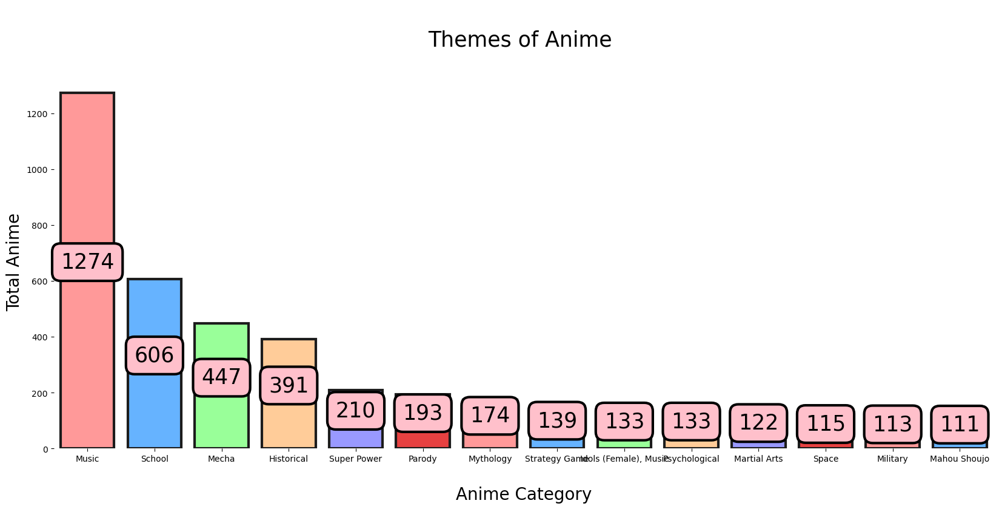

In [22]:
#visualization of how many values are in each type of anime

plt.subplots(figsize = (20,8))
palette= ['#ff9999','#66b3ff','#99ff99','#ffcc99', '#9999FF', '#E74141']
p = sns.countplot(x = myanimelist["MAL_Themes"], order = myanimelist["MAL_Themes"].value_counts()[1:15].index, palette = palette, saturation = 1,  edgecolor = "#1c1c1c", linewidth = 3)
p.axes.set_title("\nThemes of Anime \n" ,fontsize = 25)
plt.ylabel("Total Anime" ,fontsize = 20)
plt.xlabel("\nAnime Category" ,fontsize = 20)
plt.xticks(rotation = 0)
for container in p.containers:
    p.bar_label(container,label_type = "center",padding = 10,size = 25, color = "black", rotation = 0,
    bbox={"boxstyle": "round", "pad": 0.4, "facecolor": "pink", "edgecolor": "black", "linewidth": 3, "alpha":1})
sns.despine(left = True, bottom = True)
plt.show()

In order to show the amount of anime in each category in a different way from a bar chart, a pie chart is displayed below with the percentages of each type of anime in order to further understanding.

In [23]:
myanimelist['MAL_Themes']

0        Gore, Military, Survival
1                   Psychological
2                        Military
3             Parody, Super Power
4        Love Polygon, Video Game
                   ...           
17720                       Music
17737                       Music
17820                       Music
17857       Idols (Female), Music
17988       Idols (Female), Music
Name: MAL_Themes, Length: 13030, dtype: object

In [24]:
#creating a pie chart of anime type
type_list = list(themes.unique())

type_values = []

for i in range(len(themes.unique())) :

    type_values.append(themes.value_counts().iloc[i])
    
fig = px.pie(values=type_values,
             names=themes.unique(),
)

fig.update_traces(marker=dict(colors=palette),
                  hole = .3,
                  textposition='inside',
                  textinfo='percent+label'
)

fig.update_layout(
    annotations=[dict(text='Type', x=0.5, y=0.5, font_size=24, showarrow=False)],
    hoverlabel=dict(
        bgcolor="#e6ccff",
        font_size=14
    ),
    legend=dict(
        yanchor="top",
        y=0.90,
        xanchor="left",
        x=0.80
    ),
    font=dict(
        color = "purple"
    )
)
fig.show()

In [25]:
fig = px.scatter(myanimelist,
y="MAL_Themes",
x='MAL_Score',
color = "Type",
color_discrete_sequence = palette,
hover_data = ["MAL_Title"]
)
fig.update_layout(
hoverlabel=dict(
bgcolor="#e6ccff",
font_size=14
),
font=dict(
color = "Purple"
)
)
fig.show()

In [26]:
general = myanimelist.sort_values(by='MAL_Score', ascending = False)
top_50_rated = myanimelist.head(50)
top_20_rated = myanimelist.head(20)

fig = px.bar(top_20_rated,
             y="MAL_Themes",
             x="MAL_Score",
             # orientation='h',
             height=600,
             labels={
                     "Name" : "Anime"
                    },
             color = "Type",
             color_discrete_sequence=palette,
             orientation='h'
            )
fig.update_traces(hovertemplate ='%{y}' + " : " + "%{x}", selector=dict(type="bar"))

fig.update_layout(
    title = "Top Rated Studios & Their Type",
    yaxis_title = "Anime",
    xaxis_range=[5,10],
    yaxis={'categoryorder':'total ascending'},
    hoverlabel=dict(
        bgcolor="#e6ccff",
        font_size=14
    ),
    legend=dict(
        yanchor="top",
        y=0.50,
        xanchor="left",
        x=0.80,
        bgcolor="#e6ccff",
        bordercolor="purple",
        borderwidth=1
    ),
    font=dict(
        color = "Purple"
    )
)
fig.show()

### EDA Genre of anime in MyAnimeList

This section will explore this dataset to better understand the patterns in the genres of anime. There are 10 types of demographics in this dataset, but 2 have only 1 item each and 1 is Unknown, so those will be dropped. The 5 main demographics:

- Shounen: Created for boys younger than 18, typically action and adventure oriented
- Kids : Created for young children, usually are moralistic, often educating children about staying in the right path in life
- Seinen : Created for men over 18, mature topics of violence and/or psychological nature
- Shoujo : Created for girls younger than 18, typically coming of age and romance oriented
- Josei : Created for women over 18, mature topics of relationships and work life

In [27]:
#number of genres
print("Number of MAL_Genres:", myanimelist.MAL_Genres.nunique())
print(myanimelist['MAL_Genres'].value_counts()[0:20].sort_values())

print("Number of Genres:", myanimelist.Demographics.nunique())
print(myanimelist['MAL_Genres'].value_counts()[0:20].sort_values())
genres = myanimelist['MAL_Genres'][0:20].sort_values()


Number of MAL_Genres: 807
Adventure                      147
Adventure, Comedy, Fantasy     150
Action, Adventure, Sci-Fi      151
Comedy, Sci-Fi                 162
Comedy, Fantasy                173
Adventure, Fantasy             184
Comedy, Romance                199
Sci-Fi                         202
Sports                         211
Action, Fantasy                217
Drama                          250
Action, Adventure, Fantasy     256
Avant Garde                    285
Slice of Life                  308
Action                         352
Action, Sci-Fi                 367
Comedy, Slice of Life          396
Fantasy                        398
Comedy                        1094
Unknown                       1487
Name: MAL_Genres, dtype: int64
Number of Genres: 10
Adventure                      147
Adventure, Comedy, Fantasy     150
Action, Adventure, Sci-Fi      151
Comedy, Sci-Fi                 162
Comedy, Fantasy                173
Adventure, Fantasy             184
Comedy, Roma

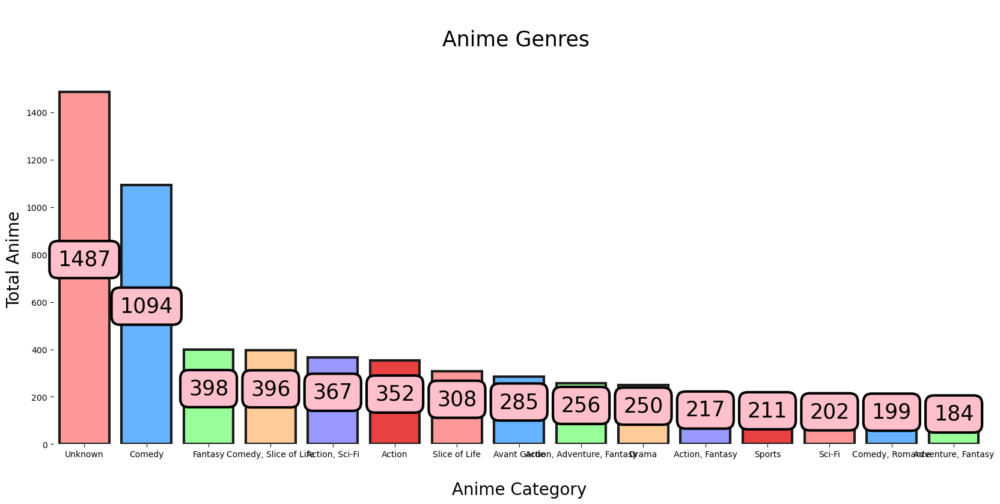

In [28]:
#visualization of how many values are in each type of anime

plt.subplots(figsize = (20,8))
palette= ['#ff9999','#66b3ff','#99ff99','#ffcc99', '#9999FF', '#E74141']
p = sns.countplot(x = myanimelist["MAL_Genres"], order = myanimelist["MAL_Genres"].value_counts()[0:15].index, palette = palette, saturation = 1,  edgecolor = "#1c1c1c", linewidth = 3)
p.axes.set_title("\nAnime Genres \n" ,fontsize = 25)
plt.ylabel("Total Anime" ,fontsize = 20)
plt.xlabel("\nAnime Category" ,fontsize = 20)
plt.xticks(rotation = 0)
for container in p.containers:
    p.bar_label(container,label_type = "center",padding = 10,size = 25, color = "black", rotation = 0,
    bbox={"boxstyle": "round", "pad": 0.4, "facecolor": "pink", "edgecolor": "black", "linewidth": 3, "alpha":1})
sns.despine(left = True, bottom = True)
plt.show()

In order to show the amount of anime in each category in a different way from a bar chart, a pie chart is displayed below with the percentages of each type of anime in order to further understanding.

In [29]:
#creating a pie chart of anime type
type_list = list(genres.unique())

type_values = []

for i in range(len(genres.unique())) :

    type_values.append(genres.value_counts().iloc[i])
    
fig = px.pie(values=type_values,
             names=genres.unique(),
)

fig.update_traces(marker=dict(colors=palette),
                  hole = .3,
                  textposition='inside',
                  textinfo='percent+label'
)

fig.update_layout(
    annotations=[dict(text='Genre', x=0.5, y=0.5, font_size=24, showarrow=False)],
    hoverlabel=dict(
        bgcolor="#e6ccff",
        font_size=14
    ),
    legend=dict(
        yanchor="top",
        y=0.90,
        xanchor="left",
        x=0.80
    ),
    font=dict(
        color = "purple"
    )
)
fig.show()

<AxesSubplot: title={'center': 'Most Popular Genres MY Anime List'}, xlabel='Genres', ylabel='Genres'>

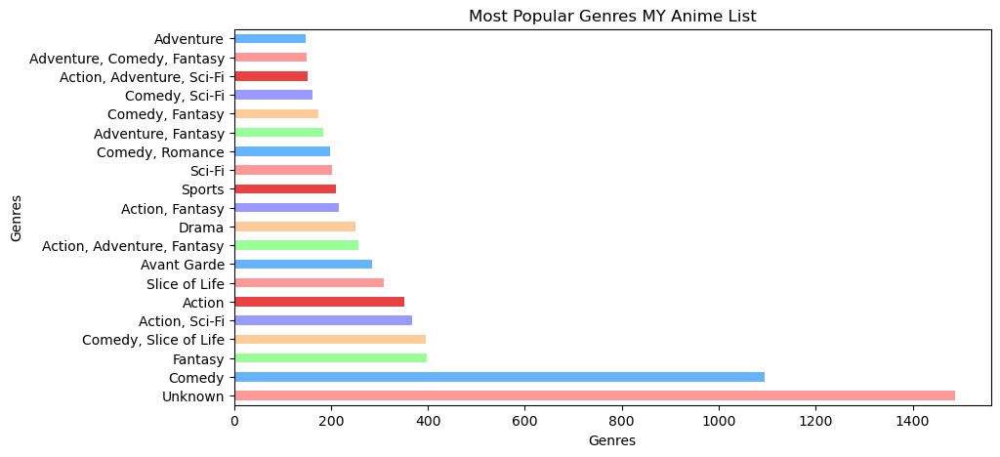

In [30]:
myanimelist['MAL_Genres'].value_counts(ascending = False)[:20].plot(title = 'Most Popular Genres MY Anime List', xlabel = 'Genres', ylabel = 'Genres', figsize=(10,5), kind='barh', color =palette)

In [31]:
fig = px.scatter(myanimelist,
y="MAL_Genres",
x='MAL_Score',
color = "Type",
color_discrete_sequence = palette,
hover_data = ["MAL_Title"]
)
fig.update_layout(
hoverlabel=dict(
bgcolor="#e6ccff",
font_size=14
),
font=dict(
color = "Purple"
)
)
fig.show()

### EDA Members of anime in MyAnimeList

In [32]:
#number of users
print("Number of Users:", myanimelist.MAL_Members.nunique())

avg_rate_peruser = myanimelist.shape[0]
user = myanimelist.MAL_Members.nunique()
avg_num_review_per_user = avg_rate_peruser/user
print("Average Number of Reveiws per User:", avg_num_review_per_user)
print("Users:", myanimelist['MAL_Members'].value_counts())

Number of Users: 9307
Average Number of Reveiws per User: 1.4000214892016762
Users: 402      14
316      12
718      11
681      11
358      10
         ..
36777     1
36778     1
36712     1
36702     1
172       1
Name: MAL_Members, Length: 9307, dtype: int64


In [33]:
fig = px.scatter(myanimelist,
y="MAL_Members",
x='MAL_Score',
color = "Type",
color_discrete_sequence = palette,
hover_data = ["MAL_Title"]
)
fig.update_layout(
hoverlabel=dict(
bgcolor="#e6ccff",
font_size=14
),
font=dict(
color = "Purple"
)
)
fig.show()

In [34]:
fig = px.scatter(myanimelist,
y="MAL_Score",
x='MAL_Members',
color = "Studios",
color_discrete_sequence = palette,
hover_data = ["MAL_Title"]
)
fig.update_layout(
hoverlabel=dict(
bgcolor="#e6ccff",
font_size=14
),
font=dict(
color = "Purple"
)
)
fig.show()

### EDA Source in MyAnimeList

This section will explore this dataset to better understand the patterns in the sources of anime. There are 10 types of sources in this dataset:

- Light Novel: style of young adult novel primarily targeting high school and middle school students

- Manga : comics or graphic novels originating from Japan

- Web manga : manga published on a website or mobile app

- Novel : a relatively long work of narrative fiction, typically written in prose and published as a book

- 4-koma manga :  comic strip format, generally consists of gag comic strips within four panels of equal size ordered from top to bottom

- Game : an electronic game that involves interaction with a user interface or input device to generate visual feedback from a display device

- Visual novel : a form of digital semi-interactive fiction

- Original : created originally for anime format

- Music : created to accompany a song or album

- Other

<AxesSubplot: xlabel='Source'>

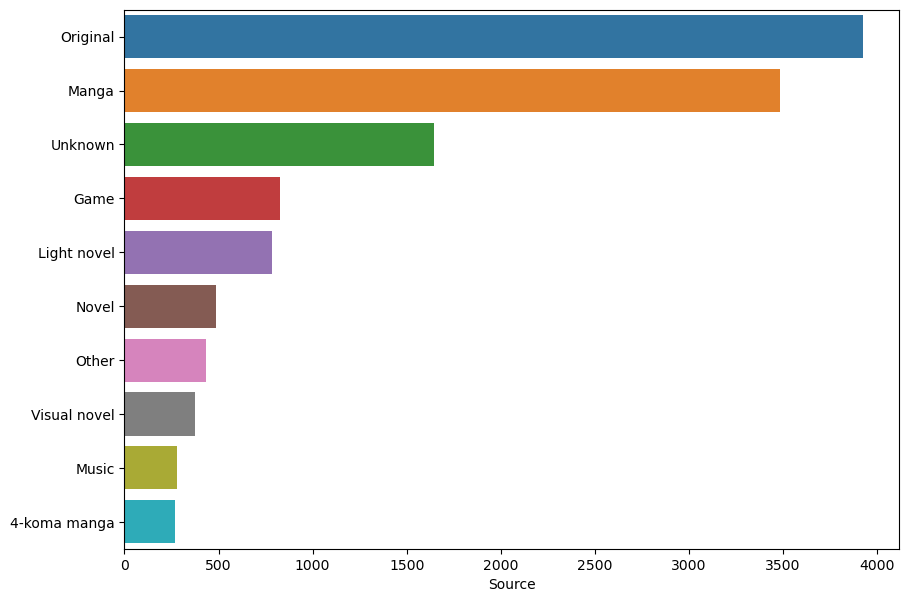

In [35]:
#barplot of number of sources of anime
source_top10= myanimelist['Source'].value_counts().head(10).index
nsource_top10 = myanimelist['Source'].value_counts().head(10)

plt.figure(figsize=(10,7))
sns.barplot( x = nsource_top10, y= source_top10)


### Correlation between MyAnimeList Attributes

The correlation between attributes as shown bellow in the correlation matrix heatmap do not show many strong correlations between many of the attributes. 

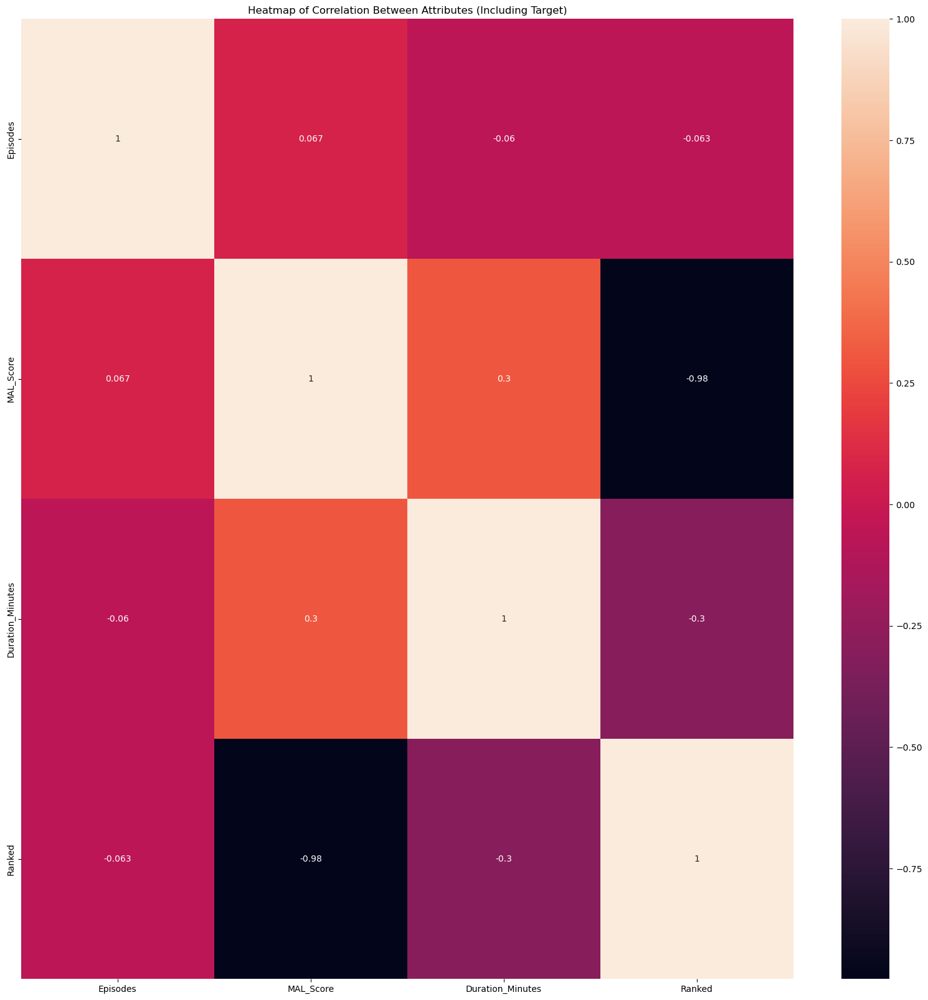

In [36]:
corr_mat = myanimelist[['Type', 'Episodes', 'Studios','MAL_Score', 'Duration_Minutes', 'Ranked', 'Source', 'Start_Aired', 'MAL_Genres']].corr()
fig, ax = plt.subplots(figsize=(20, 20))

# plot it
sns.heatmap(corr_mat, annot = True)
ax.set_title("Heatmap of Correlation Between Attributes (Including Target)");

The distribution of categorical and ordinal data is shown below. 

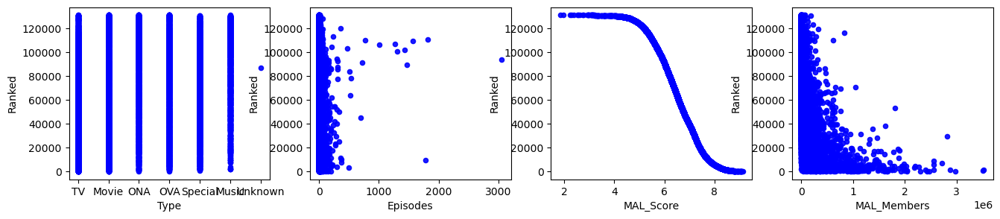

In [37]:
fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(16,3))
for xcol, ax in zip(['Type', 'Episodes', 'MAL_Score','MAL_Members'], axes):
    myanimelist.plot(kind='scatter', x=xcol, y='Ranked', ax=ax, alpha=0.9, color = 'b')

## Dataset 2 : Box Office Mojo Anime

I scraped data from Box Office Mojo's Anime movie grossing list in order to understand what anime is top in terms of money in constrast to popularity in MyAnimeList. I checked the website with \robot.txt to make sure that it was okay to scrap the data and then utilized Beautiful Soup to transform the data into a dataset.

In [38]:
URL = "https://www.boxofficemojo.com/genre/sg4259246337/"
r = requests.get(URL)
content = r.text
print(content)

<!doctype html><html class="a-no-js" data-19ax5a9jf="dingo"><head><script>var aPageStart = (new Date()).getTime();</script><meta charset="utf-8"/>
<script type='text/javascript'>var ue_t0=ue_t0||+new Date();</script>
<script type='text/javascript'>
window.ue_ihb = (window.ue_ihb || window.ueinit || 0) + 1;
if (window.ue_ihb === 1) {

var ue_csm = window,
    ue_hob = +new Date();
(function(d){var e=d.ue=d.ue||{},f=Date.now||function(){return+new Date};e.d=function(b){return f()-(b?0:d.ue_t0)};e.stub=function(b,a){if(!b[a]){var c=[];b[a]=function(){c.push([c.slice.call(arguments),e.d(),d.ue_id])};b[a].replay=function(b){for(var a;a=c.shift();)b(a[0],a[1],a[2])};b[a].isStub=1}};e.exec=function(b,a){return function(){try{return b.apply(this,arguments)}catch(c){ueLogError(c,{attribution:a||"undefined",logLevel:"WARN"})}}}})(ue_csm);


    var ue_err_chan = 'jserr-rw';
(function(d,e){function h(f,b){if(!(a.ec>a.mxe)&&f){a.ter.push(f);b=b||{};var c=f.logLevel||b.logLevel;c&&c!==k&&c!==m&&c!=

In [39]:
soup = BeautifulSoup(r.content, "html.parser")
print(soup.prettify())

<!DOCTYPE html>
<html class="a-no-js" data-19ax5a9jf="dingo">
 <head>
  <script>
   var aPageStart = (new Date()).getTime();
  </script>
  <meta charset="utf-8"/>
  <script type="text/javascript">
   var ue_t0=ue_t0||+new Date();
  </script>
  <script type="text/javascript">
   window.ue_ihb = (window.ue_ihb || window.ueinit || 0) + 1;
if (window.ue_ihb === 1) {

var ue_csm = window,
    ue_hob = +new Date();
(function(d){var e=d.ue=d.ue||{},f=Date.now||function(){return+new Date};e.d=function(b){return f()-(b?0:d.ue_t0)};e.stub=function(b,a){if(!b[a]){var c=[];b[a]=function(){c.push([c.slice.call(arguments),e.d(),d.ue_id])};b[a].replay=function(b){for(var a;a=c.shift();)b(a[0],a[1],a[2])};b[a].isStub=1}};e.exec=function(b,a){return function(){try{return b.apply(this,arguments)}catch(c){ueLogError(c,{attribution:a||"undefined",logLevel:"WARN"})}}}})(ue_csm);


    var ue_err_chan = 'jserr-rw';
(function(d,e){function h(f,b){if(!(a.ec>a.mxe)&&f){a.ter.push(f);b=b||{};var c=f.logLevel||b

In [40]:
print(soup.table.text)

Rank
Title
Lifetime GrossMax TheatersOpeningOpen ThRelease DateDistributor
1Pokémon: The First Movie - Mewtwo Strikes Back$85,744,6623,043$31,036,6783,043Nov 10, 1999Warner Bros.

2Demon Slayer the Movie: Mugen Train$49,505,0082,087$21,234,9941,614Apr 23, 2021FUNimation Entertainment

3Pokémon the Movie 2000$43,758,6842,752$19,575,6082,752Jul 21, 2000Warner Bros.

4Dragon Ball Super: Super Hero$38,112,1403,018$21,126,9193,018Aug 19, 2022Crunchyroll

5Jujutsu Kaisen 0: The Movie$34,542,7542,418$18,009,9212,286Mar 18, 2022Crunchyroll

6Dragon Ball Super: Broly$30,712,1191,267$9,816,1971,238Jan 16, 2019FUNimation Entertainment

7Yu-Gi-Oh!: The Movie - Pyramid of Light$19,765,8682,411$9,485,4942,411Aug 13, 2004Warner Bros.

8The Secret World of Arrietty$19,202,7431,522$6,446,3951,522Feb 17, 2012Walt Disney Studios Motion Pictures

9Pokémon 3 the Movie: Spell of the Unown$17,052,1282,675$8,240,7522,675Apr 6, 2001Warner Bros.

10Ponyo$15,090,399927$3,585,852927Aug 14, 2009Walt Disney Studios

In [41]:
table = soup.find_all('table')[0] 
tab_data = [[celldata.text for celldata in rowdata.find_all(["th","td"])]
            for rowdata in table.find_all("tr")]
for data in tab_data:
    print(' '.join(data))

Rank
 Title
 Lifetime Gross Max Theaters Opening Open Th Release Date Distributor

1 Pokémon: The First Movie - Mewtwo Strikes Back $85,744,662 3,043 $31,036,678 3,043 Nov 10, 1999 Warner Bros.


2 Demon Slayer the Movie: Mugen Train $49,505,008 2,087 $21,234,994 1,614 Apr 23, 2021 FUNimation Entertainment


3 Pokémon the Movie 2000 $43,758,684 2,752 $19,575,608 2,752 Jul 21, 2000 Warner Bros.


4 Dragon Ball Super: Super Hero $38,112,140 3,018 $21,126,919 3,018 Aug 19, 2022 Crunchyroll


5 Jujutsu Kaisen 0: The Movie $34,542,754 2,418 $18,009,921 2,286 Mar 18, 2022 Crunchyroll


6 Dragon Ball Super: Broly $30,712,119 1,267 $9,816,197 1,238 Jan 16, 2019 FUNimation Entertainment


7 Yu-Gi-Oh!: The Movie - Pyramid of Light $19,765,868 2,411 $9,485,494 2,411 Aug 13, 2004 Warner Bros.


8 The Secret World of Arrietty $19,202,743 1,522 $6,446,395 1,522 Feb 17, 2012 Walt Disney Studios Motion Pictures


9 Pokémon 3 the Movie: Spell of the Unown $17,052,128 2,675 $8,240,752 2,675 Apr 6, 2001 

This box office data is depicted below with 8 columns consisting of the title of the movies, lifetime gross, max theaters,opening amount, release date and distributor.

In [42]:


# Read the table into a Pandas DataFrame
df = pd.read_html(str(table))[0]
df


,Rank,Title,Lifetime Gross,Max Theaters,Opening,Open Th,Release Date,Distributor
0,1,Pokémon: The First Movie - Mewtwo Strikes Back,"$85,744,662",3043,"$31,036,678",3043,"Nov 10, 1999",Warner Bros.
1,2,Demon Slayer the Movie: Mugen Train,"$49,505,008",2087,"$21,234,994",1614,"Apr 23, 2021",FUNimation Entertainment
2,3,Pokémon the Movie 2000,"$43,758,684",2752,"$19,575,608",2752,"Jul 21, 2000",Warner Bros.
3,4,Dragon Ball Super: Super Hero,"$38,112,140",3018,"$21,126,919",3018,"Aug 19, 2022",Crunchyroll
4,5,Jujutsu Kaisen 0: The Movie,"$34,542,754",2418,"$18,009,921",2286,"Mar 18, 2022",Crunchyroll
...,...,...,...,...,...,...,...,...
95,96,Summer Wars,"$80,768",11,"$1,412",1,"Dec 24, 2010",GKIDS
96,97,Wonderful Days,"$74,663",5,"$3,022",1,"Dec 31, 2004",-
97,98,A Letter to Momo,"$71,712",7,"$4,596",1,"Jul 23, 2014",GKIDS
98,99,Trigun: Badlands Rumble,"$62,027",12,"$29,201",12,"Jul 8, 2011",Eleven Arts


In [43]:
print(df.head())
df.value_counts()

   Rank                                           Title Lifetime Gross  \
0     1  Pokémon: The First Movie - Mewtwo Strikes Back    $85,744,662   
1     2             Demon Slayer the Movie: Mugen Train    $49,505,008   
2     3                          Pokémon the Movie 2000    $43,758,684   
3     4                   Dragon Ball Super: Super Hero    $38,112,140   
4     5                     Jujutsu Kaisen 0: The Movie    $34,542,754   

   Max Theaters      Opening Open Th  Release Date               Distributor  
0          3043  $31,036,678    3043  Nov 10, 1999              Warner Bros.  
1          2087  $21,234,994    1614  Apr 23, 2021  FUNimation Entertainment  
2          2752  $19,575,608    2752  Jul 21, 2000              Warner Bros.  
3          3018  $21,126,919    3018  Aug 19, 2022               Crunchyroll  
4          2418  $18,009,921    2286  Mar 18, 2022               Crunchyroll  


Rank  Title                                                                   Lifetime Gross  Max Theaters  Opening      Open Th  Release Date  Distributor  
1     Pokémon: The First Movie - Mewtwo Strikes Back                          $85,744,662     3043          $31,036,678  3043     Nov 10, 1999  Warner Bros.     1
64    April and the Extraordinary World                                       $295,488        35            $11,413      1        Mar 25, 2016  GKIDS            1
74    Mazinger Z: INFINITY                                                    $220,682        495           $137,451     482      Feb 11, 2018  Fathom Events    1
73    Miss Hokusai                                                            $222,670        84            $24,524      2        Oct 14, 2016  GKIDS            1
72    Millennium Actress                                                      $225,250        512           -            -        Aug 13, 2019  Fathom Events    1
                           

The null values are dropped from this Box Office Mojo Anime dataset. Not many values remain, not enough for modeling, but some exploratory analyses can be performed in conjunction with the MyAnimeList dataset. 

In [44]:
print(df.isnull().sum())
df.dropna(inplace=True)
print(df.head(5))
print(df.isnull().sum())
print(f"Total number of records: {len(df)}")

Rank              0
Title             0
Lifetime Gross    0
Max Theaters      0
Opening           0
Open Th           0
Release Date      0
Distributor       0
dtype: int64
   Rank                                           Title Lifetime Gross  \
0     1  Pokémon: The First Movie - Mewtwo Strikes Back    $85,744,662   
1     2             Demon Slayer the Movie: Mugen Train    $49,505,008   
2     3                          Pokémon the Movie 2000    $43,758,684   
3     4                   Dragon Ball Super: Super Hero    $38,112,140   
4     5                     Jujutsu Kaisen 0: The Movie    $34,542,754   

   Max Theaters      Opening Open Th  Release Date               Distributor  
0          3043  $31,036,678    3043  Nov 10, 1999              Warner Bros.  
1          2087  $21,234,994    1614  Apr 23, 2021  FUNimation Entertainment  
2          2752  $19,575,608    2752  Jul 21, 2000              Warner Bros.  
3          3018  $21,126,919    3018  Aug 19, 2022               C

## Merge DataSets


In order to compare and contrast some aspects of the anime, the two datasets (MyAnimeList and Box Office Mojo) are merged together into one dataset.

In [45]:
#merge the two datasets together
anime = pd.concat([myanimelist.reset_index(drop=True), df.reset_index(drop = True)], axis =1)
print(anime.columns)
anime.head()


Index(['ID', 'MAL_Title', 'Synonyms', 'Japanese', 'English', 'Synopsis',
       'Type', 'Episodes', 'Status', 'Start_Aired', 'End_Aired', 'Premiered',
       'Broadcast', 'Producers', 'Licensors', 'Studios', 'Source',
       'MAL_Genres', 'MAL_Themes', 'Demographics', 'Duration_Minutes',
       'MAL_Rating', 'MAL_Score', 'Scored_Users', 'Ranked', 'MAL_Popularity',
       'MAL_Members', 'Favorites', 'Rank', 'Title', 'Lifetime Gross',
       'Max Theaters', 'Opening', 'Open Th', 'Release Date', 'Distributor'],
      dtype='object')


,ID,MAL_Title,Synonyms,Japanese,English,Synopsis,Type,Episodes,Status,Start_Aired,...,MAL_Members,Favorites,Rank,Title,Lifetime Gross,Max Theaters,Opening,Open Th,Release Date,Distributor
0,16498,Shingeki no Kyojin,"AoT, SnK",é²æã®å·¨äºº,Attack on Titan,"Centuries ago, mankind was slaughtered to near...",TV,25.0,Finished Airing,"Apr 7, 2013",...,3524109,155695,1.0,Pokémon: The First Movie - Mewtwo Strikes Back,"$85,744,662",3043.0,"$31,036,678",3043,"Nov 10, 1999",Warner Bros.
1,1535,Death Note,DN,ãã¹ãã¼ã,Death Note,"Brutal murders, petty thefts, and senseless vi...",TV,37.0,Finished Airing,"Oct 4, 2006",...,3504535,159701,2.0,Demon Slayer the Movie: Mugen Train,"$49,505,008",2087.0,"$21,234,994",1614,"Apr 23, 2021",FUNimation Entertainment
2,5114,Fullmetal Alchemist: Brotherhood,"Hagane no Renkinjutsushi Fullmetal Alchemist, ...",é¼ã®é¬éè¡å¸« FULLMETAL ALCHEMIST,Fullmetal Alchemist Brotherhood,After a horrific alchemy experiment goes wrong...,TV,64.0,Finished Airing,"Apr 5, 2009",...,2978455,207772,3.0,Pokémon the Movie 2000,"$43,758,684",2752.0,"$19,575,608",2752,"Jul 21, 2000",Warner Bros.
3,30276,One Punch Man,"One Punch-Man, One-Punch Man, OPM",ã¯ã³ãã³ãã³,One Punch Man,The seemingly unimpressive Saitama has a rathe...,TV,12.0,Finished Airing,"Oct 5, 2015",...,2879907,59651,4.0,Dragon Ball Super: Super Hero,"$38,112,140",3018.0,"$21,126,919",3018,"Aug 19, 2022",Crunchyroll
4,11757,Sword Art Online,"S.A.O, SAO",ã½ã¼ãã¢ã¼ãã»ãªã³ã©ã¤ã³,Sword Art Online,Ever since the release of the innovative Nerve...,TV,25.0,Finished Airing,"Jul 8, 2012",...,2813565,64997,5.0,Jujutsu Kaisen 0: The Movie,"$34,542,754",2418.0,"$18,009,921",2286,"Mar 18, 2022",Crunchyroll


In [46]:
print(f"Total number of records: {len(anime)}")

Total number of records: 13030


## EDA for merged dataset

The correlation between attributes as shown bellow in the correlation matrix heatmap do not show many strong correlations between many of the attributes.

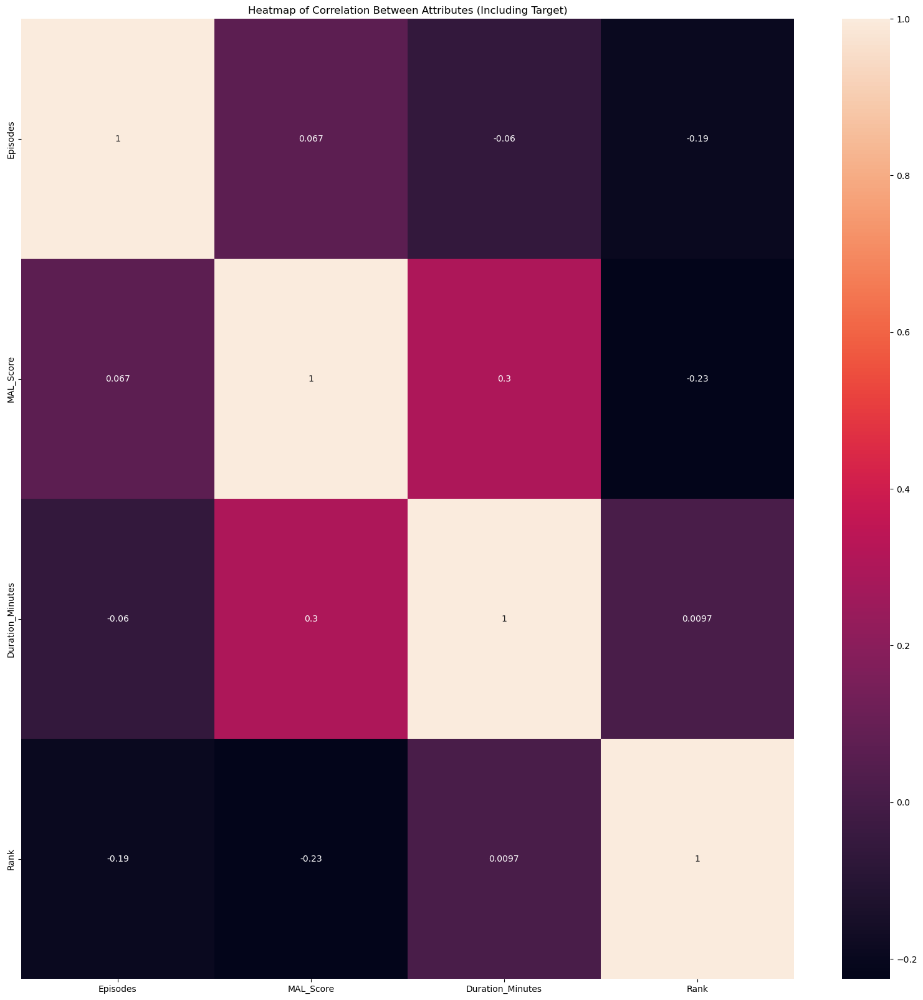

In [47]:
corr_mat = anime[['Type', 'Episodes', 'Studios','MAL_Score', 'Duration_Minutes', 'Rank', 'Source', 'Start_Aired', 'MAL_Genres', 'Lifetime Gross', 'Opening']].corr()
fig, ax = plt.subplots(figsize=(20, 20))
# plot it
sns.heatmap(corr_mat, annot = True)
ax.set_title("Heatmap of Correlation Between Attributes (Including Target)");

The distribution of distributors of the anime are depicted below. Fanthom events distributed the most movies with funimation in 2nd place.

In [48]:
data = anime['Distributor'].value_counts().sort_index(ascending=False)
trace = go.Bar(x = data.index,
               text = ['{:.1f} %'.format(val) for val in (data.values / anime.shape[0] * 100)],
               textposition = 'auto',
               textfont = dict(color = '#000000'),
               y = data.values,
              )
layout = dict(title = 'Distribution Of {} anime-ratings'.format(anime.shape[0]),
              xaxis = dict(title = 'Lifetime Gross'),
              yaxis = dict(title = 'Count'))

fig = go.Figure(data=[trace], layout=layout)
iplot(fig)


The distribution visualization below depicts the top lifetime grossing anime along with their distributor. FUNimation Entertainment had the most anime depicted. 

In [49]:
general_2 = anime.sort_values(by='Lifetime Gross')
top_50_rated = anime.head(50)
top_20_rated = anime.head(20)

fig = px.bar(top_20_rated,
             y="Title",
             x="Lifetime Gross",
             # orientation='h',
             height=600,
             labels={
                 "Name" : "Anime"
             },
             color = "Distributor",
             color_discrete_sequence=palette,
             orientation='h'
            )

fig.update_traces(hovertemplate ='%{y}' + " : " + "%{x}", selector=dict(type="bar"))

fig.update_layout(
    title = "Top Box office & Their Distributor",
    yaxis_title = "Anime",
    xaxis_range=[5,10],
    yaxis={'categoryorder':'total ascending'},
    hoverlabel=dict(
        bgcolor="#e6ccff",
        font_size=14
    ),
    legend=dict(
        yanchor="top",
        y=0.50,
        xanchor="left",
        x=0.80,
        bgcolor="#e6ccff",
        bordercolor="purple",
        borderwidth=1
    ),
    font=dict(
        color = "Purple"
    )
)
fig.show()

In [50]:
anime['New'] = anime['MAL_Title'] + anime['Title']

In [51]:
anime['New']

0        Shingeki no KyojinPokémon: The First Movie - M...
1            Death NoteDemon Slayer the Movie: Mugen Train
2        Fullmetal Alchemist: BrotherhoodPokémon the Mo...
3               One Punch ManDragon Ball Super: Super Hero
4              Sword Art OnlineJujutsu Kaisen 0: The Movie
                               ...                        
13025                                                  NaN
13026                                                  NaN
13027                                                  NaN
13028                                                  NaN
13029                                                  NaN
Name: New, Length: 13030, dtype: object

This visualization combines the two dataset to see the lifetime gross of highly scored anime.

In [52]:
general_2 = anime.sort_values(by='Lifetime Gross', ascending = False)
top_50_rated = anime.head(50)
top_20_rated = anime.head(20)

fig = px.bar(top_20_rated,
             y="New",
             x="Lifetime Gross",
             # orientation='h',
             height=600,
             labels={
                 "Name" : "Anime"
             },
             color = "MAL_Score",
             color_discrete_sequence=palette,
             orientation='h'
            )

fig.update_traces(hovertemplate ='%{y}' + " : " + "%{x}", selector=dict(type="bar"))

fig.update_layout(
    title = "Combined Dataset Titles, lifetime gross and Score",
    yaxis_title = "Anime",
    xaxis_range=[5,10],
    yaxis={'categoryorder':'total ascending'},
    hoverlabel=dict(
        bgcolor="#e6ccff",
        font_size=14
    ),
    legend=dict(
        yanchor="top",
        y=0.50,
        xanchor="left",
        x=0.80,
        bgcolor="#e6ccff",
        bordercolor="purple",
        borderwidth=1
    ),
    font=dict(
        color = "Purple"
    )
)
fig.show()

## Text Preprocessing: Tokenizing

Tokenizing is an important aspect of text classification because it will allow the program to understand the text
better before modeling. Semantic understanding is more difficult than numbers for computer programs to 
analyze, so these steps aid to make the process smoother. The cell below takes a sample document through the
preprocessing steps to pratice and also understand how the steps perform on the data before applying it to the
full data

In the cell below we apply the preprocessing steps to the full data, which includes converting all the words to
lowercase letters, stopword removal, lemmatization and tagging.

In [53]:
#text pre-processing steps:

#convert to lowercase, strip and remove punctuations
def preprocess(text):
    text = text.lower()
    text=text.strip()
    text=re.compile('<.*?>').sub('', text)
    text = re.compile('[%s]' % re.escape(string.punctuation)).sub(' ', text)
    text = re.sub('\s+', ' ', text)
    text = re.sub(r'\[[0-9]*\]',' ',text)
    text=re.sub(r'[^\w\s]', '', str(text).lower().strip())
    text = re.sub(r'\d',' ',text)
    text = re.sub(r'\s+',' ',text)
    return text


# STOPWORD REMOVAL
def stopword(string):
    a= [i for i in string.split() if i not in stopwords.words('english')]
    return ' '.join(a)


#LEMMATIZATION
# Initialize the lemmatizer
wl = WordNetLemmatizer()


# This is a helper function to map NTLK position tags
def get_wordnet_pos(tag):
    if tag.startswith('J'):
        return wordnet.ADJ
    elif tag.startswith('V'):
        return wordnet.VERB
    elif tag.startswith('N'):
        return wordnet.NOUN
    elif tag.startswith('R'):
        return wordnet.ADV
    else:
        return wordnet.NOUN
    
# Tokenize the sentence with lemmatization
                                                          
def lemmatizer(string):
    word_pos_tags = nltk.pos_tag(word_tokenize(string)) # Get position tags
    a=[wl.lemmatize(tag[0], get_wordnet_pos(tag[1])) for idx, tag in enumerate(word_pos_tags)] # Map the position tag and Lemmatize the word/token
    return " ".join(a)

In [54]:
#applying the final function of all the text pre-process onto the corpus, creating a new column


def finalpreprocess(string):
    return lemmatizer(stopword(preprocess(string)))
anime['clean_text'] = anime['Synopsis'].apply(lambda x: finalpreprocess(x))
anime.head()

,ID,MAL_Title,Synonyms,Japanese,English,Synopsis,Type,Episodes,Status,Start_Aired,...,Rank,Title,Lifetime Gross,Max Theaters,Opening,Open Th,Release Date,Distributor,New,clean_text
0,16498,Shingeki no Kyojin,"AoT, SnK",é²æã®å·¨äºº,Attack on Titan,"Centuries ago, mankind was slaughtered to near...",TV,25.0,Finished Airing,"Apr 7, 2013",...,1.0,Pokémon: The First Movie - Mewtwo Strikes Back,"$85,744,662",3043.0,"$31,036,678",3043,"Nov 10, 1999",Warner Bros.,Shingeki no KyojinPokémon: The First Movie - M...,century ago mankind slaughter near extinction ...
1,1535,Death Note,DN,ãã¹ãã¼ã,Death Note,"Brutal murders, petty thefts, and senseless vi...",TV,37.0,Finished Airing,"Oct 4, 2006",...,2.0,Demon Slayer the Movie: Mugen Train,"$49,505,008",2087.0,"$21,234,994",1614,"Apr 23, 2021",FUNimation Entertainment,Death NoteDemon Slayer the Movie: Mugen Train,brutal murder petty theft senseless violence p...
2,5114,Fullmetal Alchemist: Brotherhood,"Hagane no Renkinjutsushi Fullmetal Alchemist, ...",é¼ã®é¬éè¡å¸« FULLMETAL ALCHEMIST,Fullmetal Alchemist Brotherhood,After a horrific alchemy experiment goes wrong...,TV,64.0,Finished Airing,"Apr 5, 2009",...,3.0,Pokémon the Movie 2000,"$43,758,684",2752.0,"$19,575,608",2752,"Jul 21, 2000",Warner Bros.,Fullmetal Alchemist: BrotherhoodPokémon the Mo...,horrific alchemy experiment go wrong elric hou...
3,30276,One Punch Man,"One Punch-Man, One-Punch Man, OPM",ã¯ã³ãã³ãã³,One Punch Man,The seemingly unimpressive Saitama has a rathe...,TV,12.0,Finished Airing,"Oct 5, 2015",...,4.0,Dragon Ball Super: Super Hero,"$38,112,140",3018.0,"$21,126,919",3018,"Aug 19, 2022",Crunchyroll,One Punch ManDragon Ball Super: Super Hero,seemingly unimpressive saitama rather unique h...
4,11757,Sword Art Online,"S.A.O, SAO",ã½ã¼ãã¢ã¼ãã»ãªã³ã©ã¤ã³,Sword Art Online,Ever since the release of the innovative Nerve...,TV,25.0,Finished Airing,"Jul 8, 2012",...,5.0,Jujutsu Kaisen 0: The Movie,"$34,542,754",2418.0,"$18,009,921",2286,"Mar 18, 2022",Crunchyroll,Sword Art OnlineJujutsu Kaisen 0: The Movie,ever since release innovative nervegear gamers...


# Feature Engineering

Feature engineering aids in creating better models through manipulating, standardizing, extracting, and
preparing the data. Below we perform a train test split in order to keep a percentage of data from manipulation for a good measure against the models. In order to perform feature engineering upon the Score of each anime, it had to be rounded in order to have a more clear ordinal distribution to model

In [55]:
Score = pd.DataFrame(anime["MAL_Score"]).round()
Score

,MAL_Score
0,9.0
1,9.0
2,9.0
3,9.0
4,7.0
...,...
13025,6.0
13026,7.0
13027,6.0
13028,6.0


The dataset is separated into X and y. X is cleaned text anime column of all the anime synopses, and y is the Score of each anime. We want to model score upon the dataset in order to create a model that can predict the score of an anime due to aspects in the synopses. The data is then separated into train and test in order to keep one aspect of the data separate to test the models later on.

In [56]:
#SPLITTING THE TRAINING DATASET INTO TRAIN AND TEST

X = anime["clean_text"]

y = Score


X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.3,random_state=42)
                                                   

The cell below goes through the vectorization of the train and test set in preparation for modeling. 

In [57]:
#vectorizing the data in order to properly analyze in modeling
sw = stopwords.words('english')
vec = CountVectorizer(token_pattern=r"([a-zA-Z]+(?:'[a-z]+)?)", stop_words=sw)
X = vec.fit_transform(anime['clean_text'])
X_train_vec = vec.fit_transform(X_train)
X_train_vec = pd.DataFrame.sparse.from_spmatrix(X_train_vec)
X_train_vec.columns = sorted(vec.vocabulary_)
X_train_vec.set_index(y_train.index, inplace = True)

#Normalize the data with StandardScaler to prevent any data leakage
ss = StandardScaler(with_mean=False)
X_train_ss = ss.fit_transform(X_train_vec)
X_train_ss = X_train_ss.toarray()

#vectorizing and normalizing the data with StandardScaler for the X_test
X_test_vec = vec.transform(X_test)
X_test_vec =pd.DataFrame.sparse.from_spmatrix(X_test_vec)
X_test_vec.columns = sorted(vec.vocabulary_)
X_test_vec.set_index(y_test.index, inplace = True)
X_test_ss = ss.fit_transform(X_test_vec)

#vectorizing the data in order to properly analyze in modeling
X = vec.fit_transform(anime['clean_text'])
X_train_vec = vec.fit_transform(X_train)
X_train_vec = pd.DataFrame.sparse.from_spmatrix(X_train_vec)
X_train_vec.columns = sorted(vec.vocabulary_)
X_train_vec.set_index(y_train.index, inplace = True)


A vectorized dataset should have each word separated out; in order to perform frequency distributions this is imperative. Therefore the newly made vectorized dataframe is checked below and it correctly separates out each word.

In [58]:
#checking the data to ensure properly vectorized
X_train_vec.set_index(y_train.index)

,aa,aaa,aah,aanimationn,aaron,aast,aasu,aaya,ab,aback,...,zuruggu,zushioumaru,zutomayo,zutto,zuuma,zuzu,zvezda,zwei,zygarde,zz
12870,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9239,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1886,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3003,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
23,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11964,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5191,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5390,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
860,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### Frequency of Words Appearing in Anime Dataset

In order to further understand the synopses of anime and to look further into understanding each theme or genre the synpopses depict, a frequency distribution is utilized below along with a companian bar chart. 

The top 15 most common words among all the anime synopsis are displayed below. They can be used in order to better understand the synopses and the overall anime dataset. For examlpe, 'school' is very high which indicates that stories that take place in school is more common than those in an office or a fantasy world. Girl is also stated, but not boys, which could mean that more girls are involved in the stories overall. 

In [59]:
#Frequency Distribution to see what words were more commonly written throughout the tweets
freq_dist = FreqDist(X_test_vec)
print(freq_dist)
print("\n")
top_25 = X_train_vec.sum().sort_values(ascending=False)[:25].index
print(top_25)


<FreqDist with 30828 samples and 30828 outcomes>


Index(['source', 'one', 'world', 'write', 'mal', 'rewrite', 'school', 'girl',
       'new', 'life', 'year', 'find', 'however', 'take', 'friend', 'day',
       'time', 'make', 'become', 'ann', 'two', 'story', 'name', 'young',
       'live'],
      dtype='object')


The top 15 most common words among all the anime synopsis are displayed below in a barchart in order to understand how common some are in comparison to others. There is a huge difference between the top two words, source and one, for example. 

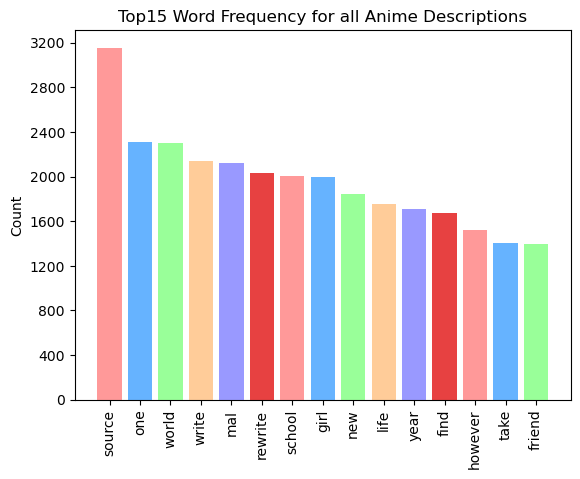

In [60]:
def visualize_top_25(freq_dist, title):
    
# Extract data for plotting
    top_15 = list(zip(*freq_dist.most_common(15)))
    tokens = top_25[0]
    counts = top_25[1]
    
# Set up plot and plot data
fig, ax = plt.subplots()
color= ['#ff9999','#66b3ff','#99ff99','#ffcc99', '#9999FF', '#E7414']
ax.bar(X_train_vec.sum().sort_values(ascending=False)[:15].index, X_train_vec.sum().sort_values(ascending=False)[:15], color = palette)

# Customize plot appearance
palette= ['#ff9999','#66b3ff','#99ff99','#ffcc99', '#9999FF', '#E74141']
ax.set_title("Top15 Word Frequency for all Anime Descriptions")
ax.set_ylabel("Count")
ax.yaxis.set_major_locator(MaxNLocator(integer=True))
ax.tick_params(axis="x", rotation=90)
visualize_top_25(freq_dist, "Top15 Word Frequency for all Anime Descriptions")

It is imperative to check the shape of the data after cleaning and organizing in order to ensure that there is enough anime to perform modeling upon. Although it would be ideal to have more 13,030 items, it is sufficient for modeling. 

In [61]:
anime.shape

(13030, 38)

## Modeling - supervised

The supervised base models below will be trained on the data in order to uncover which might be best to hypertune. These models are trained on the clean text synopses in order to predict the rating of the anime.

In [62]:
#instantiating models within a dictionary in order to establish baselin
models = {}
# Logistic Regression
models['Logistic Regression'] = LogisticRegression()
# Support Vector Machines
models['Support Vector Machines'] = LinearSVC()
# Stochastic Gradient Descent
models['Stochastic Gradient Descent'] = SGDClassifier()
# Random Forest
models['Random Forest'] = RandomForestClassifier()
# Naive Bayes
models['Naive Bayes'] = GaussianNB()
# K-Nearest Neighbors
models['K-Nearest Neighbor'] = KNeighborsClassifier()

In [63]:
#looking for accuracy, precision and recall scores within the baseline

# from sklearn import preprocessing
# from sklearn import utils

lab = preprocessing.LabelEncoder()
y_transformed = lab.fit_transform(y_train)



In [64]:
#view transformed values
# print(y_transformed)
accuracy, precision, recall = {}, {}, {}

for key in models.keys():
    
    # Fit the classifier
    models[key].fit(X_train_ss, y_train)
    
    # Make predictions
    predictions = models[key].predict(X_test_ss.toarray())
    
    
    accuracy[key] = accuracy_score(y_test, predictions)
    precision[key] = precision_score(y_test, predictions, average = 'weighted')
    recall[key] = recall_score(y_test, predictions, average = 'weighted')

The 6 basic models's classification metrics are displayed in a table below to better visualize which did better in each metric based on the numbers. Overall Random Forest performed the best and will be hypertuned in the next section. 

In [65]:
#printing out accuracy, precision, and recall scores from each of those
df_model = pd.DataFrame(index=models.keys(), columns=['Accuracy', 'Precision', 'Recall']) 
df_model['Accuracy'] = accuracy.values()
df_model['Precision'] = precision.values()
df_model['Recall'] = recall.values()
columns=['Accuracy', 'Precision', 'Recall']
modeltable_basic1 = (tabulate(df_model, headers = columns, tablefmt="grid"))
print(modeltable_basic1)


+-----------------------------+------------+-------------+----------+
|                             |   Accuracy |   Precision |   Recall |
+=============================+============+=============+==========+
| Logistic Regression         |   0.436685 |    0.431119 | 0.436685 |
+-----------------------------+------------+-------------+----------+
| Support Vector Machines     |   0.382962 |    0.385    | 0.382962 |
+-----------------------------+------------+-------------+----------+
| Stochastic Gradient Descent |   0.457406 |    0.462399 | 0.457406 |
+-----------------------------+------------+-------------+----------+
| Random Forest               |   0.487081 |    0.505274 | 0.487081 |
+-----------------------------+------------+-------------+----------+
| Naive Bayes                 |   0.376567 |    0.39435  | 0.376567 |
+-----------------------------+------------+-------------+----------+
| K-Nearest Neighbor          |   0.352264 |    0.392346 | 0.352264 |
+-------------------

The 6 basic models's classification metrics are displayed in a bar chart below to better visualize which did better in each metric.

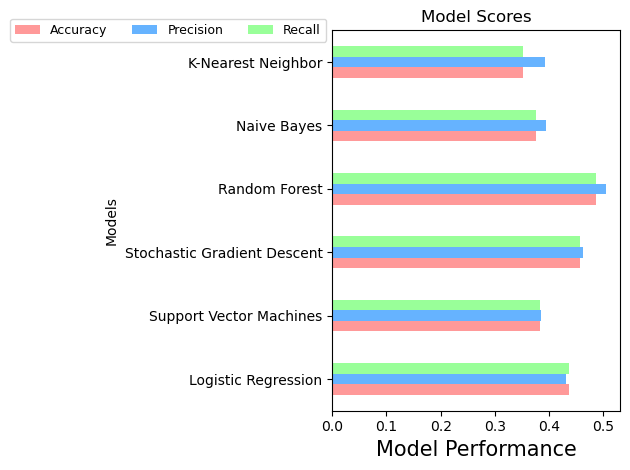

In [66]:
#Plotting the accuracy, precision and recall scores of the baseline mod
color = ['#ff9999','#66b3ff','#99ff99','#ffcc99']
ax = df_model.plot.barh(title = 'Model Scores', color = color)
ax.legend(
ncol=len(models.keys()),
bbox_to_anchor=(0, 1),
loc='right',
prop={'size': 9},
)
ax.set_xlabel('Model Performance', fontsize=15)
ax.set_ylabel('Models', fontsize='medium')
plt.tight_layout()


A confusion matrix of each basic model are displayed in order to compare. In order to display them, the models are placed in a dictionary and then plotted in the next two cells. 

In [67]:
models2 = {}
# Logistic Regression
models2['Logistic Regression'] = LogisticRegression()
# Support Vector Machines
models2['Support Vector Machines'] = LinearSVC()
# Stochastic Gradient Descent
models2['Stochastic Gradient Descent'] = SGDClassifier()
# Random Forest
models2['Random Forest'] = RandomForestClassifier()
# Naive Bayes
models2['Naive Bayes'] = GaussianNB()

Confusion Matrix allows us to measure Recall, Precision, Accuracy the model. The true and false positives and negatives are not as easy to understand in multiclass as they are with binary problems. What this confusion matrix tells us is that the diagonal values are the respective classes' TP(True positive) values. True positives are when the predicted values to be positive and are actually positive. The confusion matrices below depict that Random Forest has the best confusion matrix as the larger numbers are within the diagonal, leading that when that score was predicted upon the anime synopsis, it was correct in it's prediction. 

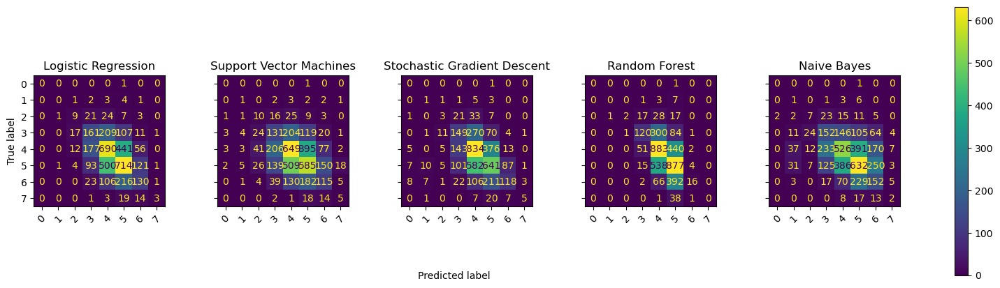

In [68]:
f, axes = plt.subplots(1, 5, figsize=(20, 5), sharey='row')

for i, (key, models2) in enumerate(models2.items()):
    y_pred = models2.fit(X_train_ss, y_train).predict(X_test_ss.toarray())
    cf_matrix = confusion_matrix(y_test, y_pred)
    disp = ConfusionMatrixDisplay(cf_matrix)
    disp.plot(ax=axes[i], xticks_rotation=45)
    disp.ax_.set_title(key)
    disp.im_.colorbar.remove()
    disp.ax_.set_xlabel('')
    if i!=0:
        disp.ax_.set_ylabel('')

f.text(0.4, 0.1, 'Predicted label', ha='left')
plt.subplots_adjust(wspace=0.40, hspace=0.1)


f.colorbar(disp.im_, ax=axes)
plt.show()

## Hypertuned Models

There are 3 hypertuned models below, Random Forest, Logistic Regression and Multinomial Naive Bayes. The later two utilize pipelines for their vectorizing and scaling. The parameters are listed for all 3 models to iterate through. The best parameters are listed as well as their confusion matrix and the prediction of how the model does on train and test data. However, overall the models perform not optimally.

In [69]:
#gridsearch for best parameters in Random Forest
rf = RandomForestClassifier()   

param_dist = {"max_depth": [3, 5], 
    "max_features": ['auto', 'sqrt'], 
    "min_samples_split": [2, 5, 10], 
    "bootstrap": [True, False], 
    "criterion": ["gini", "entropy"]} 


rf_random = RandomizedSearchCV(estimator = rf,  param_distributions = param_dist, n_iter = 100, cv = 3, verbose=2, random_state=42, n_jobs = 1)
grid_result_rf = rf_random.fit(X_train_ss, np.ravel(y_train))

# summarize results
print("Best: %f using %s" % (grid_result_rf.best_score_, grid_result_rf.best_params_))

rf_best = grid_result_rf.best_params_


y_pred_rf = grid_result_rf.predict(X_test_ss.toarray())
y_pred_rn_train = grid_result_rf.predict(X_train_ss)

print('recall %s' % recall_score(y_pred_rf, y_test,  average = 'weighted'))
print(classification_report(y_test, y_pred_rf))
print('Training set recall: ', metrics.recall_score(y_train, y_pred_rn_train,  average = 'weighted'))
print('Test set recall: ',metrics.recall_score(y_test, y_pred_rf,  average = 'weighted'))

#classification report of the improved random Forest model
print(classification_report(y_test, y_pred_rf))
print(confusion_matrix(y_test, y_pred_rf))



Fitting 3 folds for each of 48 candidates, totalling 144 fits
[CV] END bootstrap=True, criterion=gini, max_depth=3, max_features=auto, min_samples_split=2; total time=   4.1s
[CV] END bootstrap=True, criterion=gini, max_depth=3, max_features=auto, min_samples_split=2; total time=   4.1s
[CV] END bootstrap=True, criterion=gini, max_depth=3, max_features=auto, min_samples_split=2; total time=   4.1s
[CV] END bootstrap=True, criterion=gini, max_depth=3, max_features=auto, min_samples_split=5; total time=   4.1s
[CV] END bootstrap=True, criterion=gini, max_depth=3, max_features=auto, min_samples_split=5; total time=   4.1s
[CV] END bootstrap=True, criterion=gini, max_depth=3, max_features=auto, min_samples_split=5; total time=   4.1s
[CV] END bootstrap=True, criterion=gini, max_depth=3, max_features=auto, min_samples_split=10; total time=   4.1s
[CV] END bootstrap=True, criterion=gini, max_depth=3, max_features=auto, min_samples_split=10; total time=   4.1s
[CV] END bootstrap=True, criteri

[CV] END bootstrap=True, criterion=entropy, max_depth=5, max_features=sqrt, min_samples_split=10; total time=   5.9s
[CV] END bootstrap=False, criterion=gini, max_depth=3, max_features=auto, min_samples_split=2; total time=   5.6s
[CV] END bootstrap=False, criterion=gini, max_depth=3, max_features=auto, min_samples_split=2; total time=   5.6s
[CV] END bootstrap=False, criterion=gini, max_depth=3, max_features=auto, min_samples_split=2; total time=   5.7s
[CV] END bootstrap=False, criterion=gini, max_depth=3, max_features=auto, min_samples_split=5; total time=   5.6s
[CV] END bootstrap=False, criterion=gini, max_depth=3, max_features=auto, min_samples_split=5; total time=   5.6s
[CV] END bootstrap=False, criterion=gini, max_depth=3, max_features=auto, min_samples_split=5; total time=   5.7s
[CV] END bootstrap=False, criterion=gini, max_depth=3, max_features=auto, min_samples_split=10; total time=   5.6s
[CV] END bootstrap=False, criterion=gini, max_depth=3, max_features=auto, min_sample

[CV] END bootstrap=False, criterion=entropy, max_depth=5, max_features=sqrt, min_samples_split=10; total time=   8.3s
[CV] END bootstrap=False, criterion=entropy, max_depth=5, max_features=sqrt, min_samples_split=10; total time=   8.3s
Best: 0.449951 using {'min_samples_split': 2, 'max_features': 'sqrt', 'max_depth': 5, 'criterion': 'gini', 'bootstrap': False}
recall 0.4410335124072653
              precision    recall  f1-score   support

         2.0       0.00      0.00      0.00         1
         3.0       0.00      0.00      0.00        11
         4.0       0.00      0.00      0.00        65
         5.0       0.00      0.00      0.00       506
         6.0       0.43      0.77      0.55      1376
         7.0       0.46      0.47      0.46      1434
         8.0       0.00      0.00      0.00       476
         9.0       0.00      0.00      0.00        40

    accuracy                           0.44      3909
   macro avg       0.11      0.15      0.13      3909
weighted avg   

This confusion matrix does improve upon the base random forest one a few cells above in that the numbers in the diagonals are even higher which means that the scores were more correctly predicted upon the genre data. 

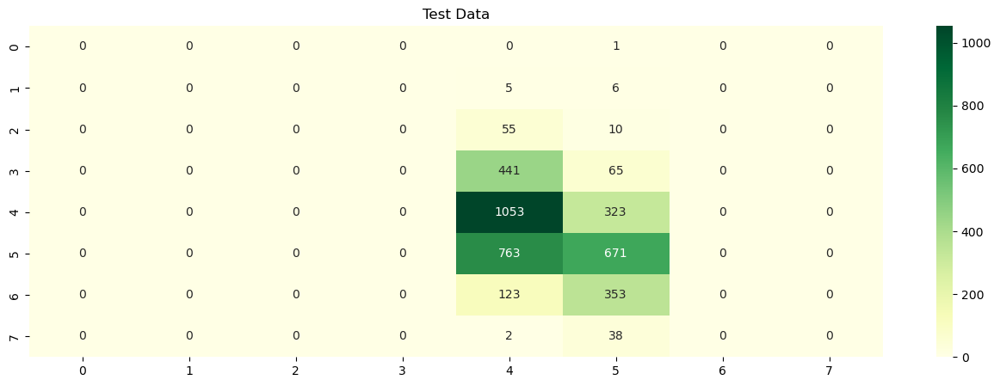

In [70]:
# confusion matrix heatmap for the Random Forest model

group_names = ['True Pos', 'False Pos', 'False Neg', 'True Neg']
test_cnf_matrix = confusion_matrix(y_test,y_pred_rf)
test_counts = ["{0:0.0f}".format(value) for value in test_cnf_matrix.flatten()]
test_percentage = ["{0:.2%}".format(value) for value in test_cnf_matrix .flatten()/np.sum(test_cnf_matrix)]
test_labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,test_counts,test_percentage)]
test_labels = np.asarray(test_labels).reshape(2,2)
plt.figure(figsize = (16,5))
sns.heatmap(test_cnf_matrix, annot = True, fmt='', cmap="YlGn").set_title('Test Data');

ROC AUC and Cohen Kappa scores are calibrated below in order to understand how efficient the model is. A good score for AUC ROC is between .8-.9, so .67 is a bit lower than that and is therefore considered a 'poor model'. In comparison the Cohen Kappa score is extremely low at .14 when .81-1 is considered optimal. Therefore this model is not recommended. 

In [71]:

# predict probabilities ROC_AUC on hypertuned Random Forest model
calibrator = CalibratedClassifierCV(rf_random, cv='prefit')
model_rf=calibrator.fit(X_train_ss, y_train)
y_pred_rf = rf_random.predict((X_test_ss))
yhat_rf = rf_random.predict_proba(X_test_ss)

# retrieve just the probabilities for the positive class
pos_probs_rf = yhat_rf[:, 1]

print(roc_auc_score(
    y_test, yhat_rf, average="weighted", multi_class="ovr"
))


#Generally, a score above 0.8 is considered great. The score we got is poor.
from sklearn.metrics import cohen_kappa_score

print(cohen_kappa_score(y_test, y_pred_rf))


0.6695911280683524
0.12990959730598073


Hypertuning our second model: Logistic Regression because it was one of the higher results from the basic models. This model was placed in a pipeline along with 2 different vectorizers and a standardScaler. The best parameters are listed, along with the classification metrix results, the test and training recall (the training perfomed extremely well but only .45 for the test data), and a confusion matrix (which is combined with a heatmap in the next cell to better understand). This model has some of the higher scores among the other models, but overall is quite low.

In [72]:
pipeline = Pipeline([('vect', CountVectorizer()),
               ('tfidf', TfidfTransformer()),
               ('ss', StandardScaler(with_mean=False)),
               ('clf', LogisticRegression())
              ])


parameters = {
    'vect__max_df': (0.5, 0.75, 1.0),
    'tfidf__use_idf': (True, False),
    "clf__max_iter": [20, 50, 100, 200],
    "clf__solver": ['sag', 'liblinear', 'saga', 'lbfgs', 'newton-cg'],
    "clf__class_weight": ["balanced"],
    "clf__penalty" : ['elasticnet', 'l2', 'l1', 'none'],
    'clf__C' : [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000]
}

grid_search_clf = RandomizedSearchCV(pipeline, parameters)

grid_search_clf.fit(X_train, np.ravel(y_train))

y_pred_lg_train = grid_search_clf.predict(X_train)
y_pred_lg = grid_search_clf.predict(list(X_test))


print("Best Params: ", grid_search_clf.best_params_)
print('recall %s' % recall_score(y_pred_lg, y_test, average = 'weighted'))
print(classification_report(y_test, y_pred_lg))
print('Training set recall: ', metrics.recall_score(y_train, y_pred_lg_train, average='weighted'))
print('Test set recall: ',metrics.recall_score(y_test, y_pred_lg, average='weighted'))
#classification report of the improved Logistic Regression model
print(classification_report(y_test, y_pred_lg))
print(confusion_matrix(y_test, y_pred_lg))

Best Params:  {'vect__max_df': 0.5, 'tfidf__use_idf': True, 'clf__solver': 'liblinear', 'clf__penalty': 'l2', 'clf__max_iter': 100, 'clf__class_weight': 'balanced', 'clf__C': 0.001}
recall 0.46866206190841647
              precision    recall  f1-score   support

         2.0       0.00      0.00      0.00         1
         3.0       0.00      0.00      0.00        11
         4.0       0.25      0.15      0.19        65
         5.0       0.46      0.32      0.38       506
         6.0       0.50      0.52      0.51      1376
         7.0       0.49      0.53      0.51      1434
         8.0       0.42      0.38      0.40       476
         9.0       0.19      0.12      0.15        40

    accuracy                           0.47      3909
   macro avg       0.29      0.25      0.27      3909
weighted avg       0.47      0.47      0.47      3909

Training set recall:  0.9600920951650038
Test set recall:  0.46866206190841647
              precision    recall  f1-score   support

      

The confusion matrix below does show quite a few false positives, when the observation is predicted to be positive but is actually negative. This means that the scoring that is predicted is not always true and that leads to this model not being optimal to predict scores amongst the synopses. It is not as good as the hypertuned random forest model at predicting the correct score on the anime synopses.

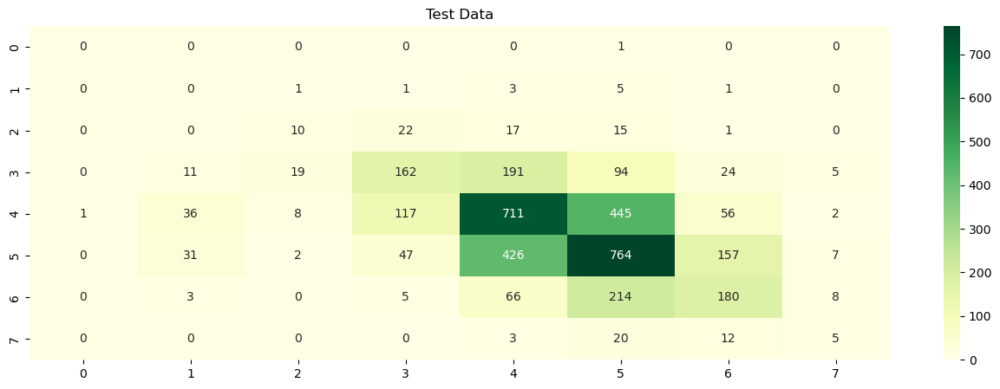

In [73]:
# confusion matrix heatmap for hypertuned Logistic Rregression model
group_names = ['True Pos', 'False Pos', 'False Neg', 'True Neg']
test_cnf_matrix = confusion_matrix(y_test,y_pred_lg)
test_counts = ["{0:0.0f}".format(value) for value in test_cnf_matrix.flatten()]
test_percentage = ["{0:.2%}".format(value) for value in test_cnf_matrix .flatten()/np.sum(test_cnf_matrix)]
test_labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,test_counts,test_percentage)]
test_labels = np.asarray(test_labels).reshape(2,2)
plt.figure(figsize = (16,5))
sns.heatmap(test_cnf_matrix, annot = True, fmt='', cmap="YlGn").set_title('Test Data');

Hypertuning with pipeline for Multinomial Naive Bayes model because it is usually associated with Natural Language Processing models. This model was placed in a pipeline along with 2 different vectorizers and a standardScaler. The best parameters are listed, along with the classification metrix results, the test and training recall (unforunately very low for test) and a confusion matrix (which is combined with a heatmap in the next cell to better understand). This model is ended up with the lowest recall scores overall and would not be good to recommend or implement upon new data. 

In [74]:
pipeline = Pipeline([('vect', CountVectorizer()),
               ('tfidf', TfidfTransformer()),
               ('ss', StandardScaler(with_mean=False)),
               ('clf', MultinomialNB())
              ])

parameters = {
    'vect__max_df': (0.5, 0.75, 1.0),
    'tfidf__use_idf': (True, False) 
}

grid_search_clf = RandomizedSearchCV(pipeline, parameters)

grid_search_clf.fit(X_train, y_train)

y_pred_nb_train = grid_search_clf.predict(X_train)
y_pred_nb = grid_search_clf.predict(list(X_test))


print("Best Params: ", grid_search_clf.best_params_)
print('recall %s' % recall_score(y_pred_nb, y_test, average = 'weighted'))
print(classification_report(y_test, y_pred_nb))
print('Training set recall: ', metrics.recall_score(y_train, y_pred_nb_train, average='weighted'))
print('Test set recall: ',metrics.recall_score(y_test, y_pred_nb, average='weighted'))
#classification report of the improved knn model
print(classification_report(y_test, y_pred_nb))
print(confusion_matrix(y_test, y_pred_nb))



Best Params:  {'vect__max_df': 0.5, 'tfidf__use_idf': False}
recall 0.39293937068303914
              precision    recall  f1-score   support

         2.0       0.00      0.00      0.00         1
         3.0       0.00      0.00      0.00        11
         4.0       0.14      0.14      0.14        65
         5.0       0.38      0.30      0.34       506
         6.0       0.51      0.43      0.46      1376
         7.0       0.49      0.41      0.44      1434
         8.0       0.33      0.40      0.36       476
         9.0       0.12      0.25      0.17        40

    accuracy                           0.39      3909
   macro avg       0.25      0.24      0.24      3909
weighted avg       0.45      0.39      0.42      3909

Training set recall:  0.9373972152176296
Test set recall:  0.39293937068303914
              precision    recall  f1-score   support

         2.0       0.00      0.00      0.00         1
         3.0       0.00      0.00      0.00        11
         4.0       

 The confusion matrix below predicts the scores of the anime from the anime synopses the least well and therefore would not be a good model to utilize. 

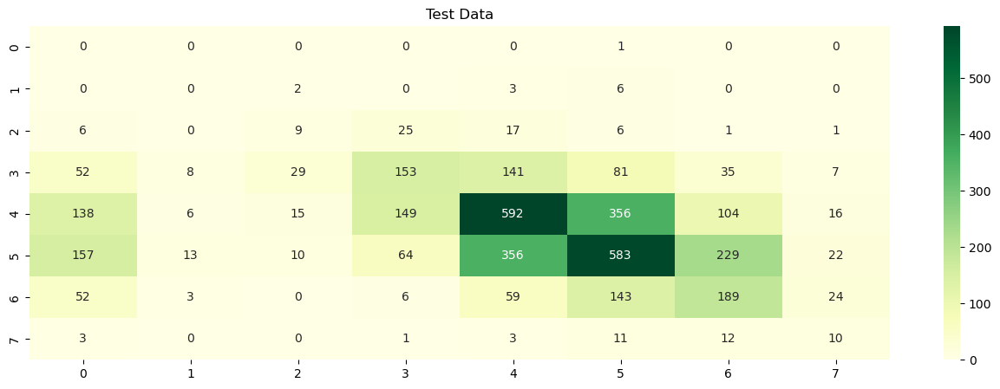

In [75]:
# confusion matrix heatmap for the MultinomialNB model

group_names = ['True Pos', 'False Pos', 'False Neg', 'True Neg']
test_cnf_matrix = confusion_matrix(y_test,y_pred_nb)
test_counts = ["{0:0.0f}".format(value) for value in test_cnf_matrix.flatten()]
test_percentage = ["{0:.2%}".format(value) for value in test_cnf_matrix .flatten()/np.sum(test_cnf_matrix)]
test_labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,test_counts,test_percentage)]
test_labels = np.asarray(test_labels).reshape(2,2)
plt.figure(figsize = (16,5))
sns.heatmap(test_cnf_matrix, annot = True, fmt='', cmap="YlGn").set_title('Test Data');

## Comparing the hypertuned models

There were 3 models that were hypertuned in order to discover the best overall model and they were Random Forest, Logistic Regression and MultinomialNB. They are compared in this section based on classification metrics. All performed poorly but Logistic Regression had the best overall scores in each area. The 3 models are placed in a dictionary below and then displayed in a table and bar chart to better visualize.

In [76]:
#Comparing the hypertuned models by putting them in a dictionary
models_tuned = {}

# Multinomial Naive Bayes
models_tuned['Multinomial Naive Bayes'] = MultinomialNB()

# Logistic Regression
models_tuned['Logistic Regression'] = LogisticRegression(C= 0.01, class_weight='balanced', max_iter=50, penalty='l2', solver='saga')

#Random Forest
models_tuned['Random Forest'] = RandomForestClassifier(n_estimators= 1400, min_samples_split= 5, min_samples_leaf= 2, max_features= 'auto', max_depth= 5, criterion = 'entropy', bootstrap = True)
                                                     

In [77]:
accuracy, precision, recall = {}, {}, {}

for key in models_tuned.keys():
    
    # Fit the classifier
    models_tuned[key].fit(X_train_ss, y_train)
    
    # Make predictions
    predictions = models_tuned[key].predict(X_test_ss.toarray())
    
    
    accuracy[key] = accuracy_score(y_test, predictions)
    precision[key] = precision_score(y_test, predictions, average = 'weighted')
    recall[key] = recall_score(y_test, predictions, average = 'weighted')

The highest Accuracy, Precision, and Recall was in the hypertuned Logistic Regression model, however, all of the scores below are below .50 and are not great to perform upon new data. 

In [78]:
#printing out accuracy, precision, and recall scores from each of those
df_model_tuned = pd.DataFrame(index=models_tuned.keys(), columns=['Accuracy', 'Precision', 'Recall'])
df_model_tuned['Accuracy'] = accuracy.values()
df_model_tuned['Precision'] = precision.values()
df_model_tuned['Recall'] = recall.values()
columns=['Accuracy', 'Precision', 'Recall']
modeltable_tuned = (tabulate(df_model_tuned, headers = columns, tablefmt="grid"))
print(modeltable_tuned)

+-------------------------+------------+-------------+----------+
|                         |   Accuracy |   Precision |   Recall |
+=========================+============+=============+==========+
| Multinomial Naive Bayes |   0.417754 |    0.446479 | 0.417754 |
+-------------------------+------------+-------------+----------+
| Logistic Regression     |   0.479151 |    0.488433 | 0.479151 |
+-------------------------+------------+-------------+----------+
| Random Forest           |   0.446917 |    0.324065 | 0.446917 |
+-------------------------+------------+-------------+----------+


The hypertuned models's classificiation metrics are shown below in a bar chart. The hypertuned Logistic Regression model performed best in each metric in compared to the other two models, but in general each model recieved low scores. 

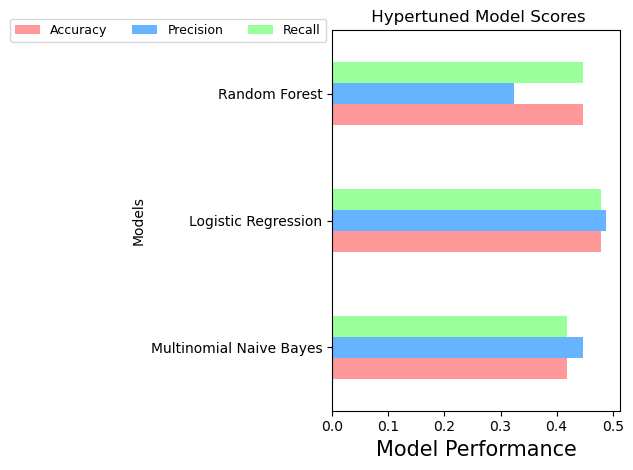

In [79]:
#Plotting the accuracy, precision and recall scores of the baseline mod
color = ['#ff9999','#66b3ff','#99ff99','#ffcc99']
ax = df_model_tuned.plot.barh(title = ' Hypertuned Model Scores', color = color)
ax.legend(
ncol=len(models_tuned.keys()),
bbox_to_anchor=(0, 1),
loc='right',
prop={'size': 9},
)
ax.set_xlabel('Model Performance', fontsize=15)
ax.set_ylabel('Models', fontsize='medium')
plt.tight_layout()


## Modeling - Unsupervised

Although unsupervised methods might be best suited to datasets containing more data and less labels, they can still aid in discovering more patterns and aspects of the data. The elbow method depicted below indicates that there are 9 clusters in our data

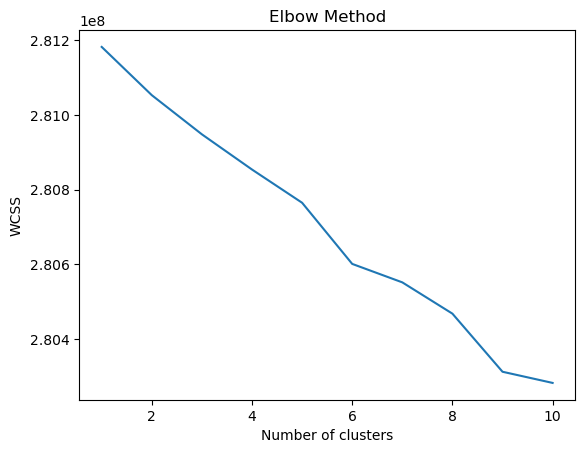

In [80]:
from sklearn.cluster import KMeans
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
    kmeans.fit(X_train_ss)
    wcss.append(kmeans.inertia_)
plt.plot(range(1, 11), wcss)
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

The number of clusters (9) was learned using the elbow method above. That is utilized to build the model below. 

In [81]:
# Building the model with 9 clusters
kmode = KMeans(n_clusters=9, init = "random", n_init = 5, verbose=1)
clusters = kmode.fit_predict(X_train_ss)
clusters

Initialization complete
Iteration 0, inertia 283535113.45045984.
Iteration 1, inertia 280795888.77641827.
Iteration 2, inertia 280794617.11477494.
Converged at iteration 2: strict convergence.
Initialization complete
Iteration 0, inertia 285605235.0517951.
Iteration 1, inertia 280895485.48881316.
Converged at iteration 1: strict convergence.
Initialization complete
Iteration 0, inertia 315351941.046145.
Iteration 1, inertia 280919589.77352196.
Iteration 2, inertia 280912196.12322164.
Iteration 3, inertia 280908585.4119543.
Iteration 4, inertia 280906562.82875687.
Iteration 5, inertia 280904805.3629181.
Iteration 6, inertia 280903392.06750596.
Iteration 7, inertia 280903008.9162073.
Iteration 8, inertia 280902666.64398634.
Iteration 9, inertia 280902202.5559657.
Iteration 10, inertia 280900834.46745336.
Iteration 11, inertia 280897888.6946334.
Iteration 12, inertia 280896832.20586044.
Converged at iteration 12: strict convergence.
Initialization complete
Iteration 0, inertia 290981423.9

array([3, 3, 3, ..., 3, 3, 3], dtype=int32)

The Confusion matrix below of the Kmeans data displays that most scores are between 5-8 and 

The 9 clusters of our data is displayed below with each color separating the clusters. They are not as separated as we would want inferring that there is a lot of similarity among the clusters.

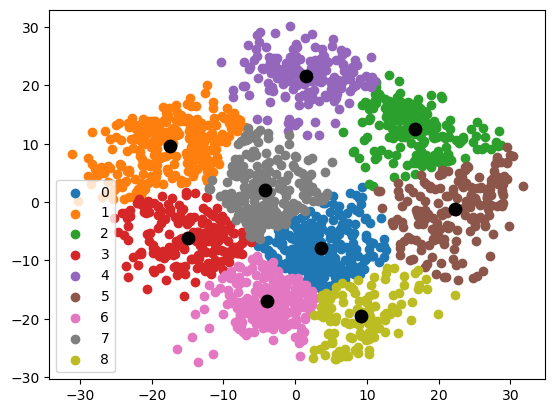

In [82]:
#Getting the Centroids
#Load Data
data = load_digits().data
pca = PCA(2)
 
#Transform the data
df = pca.fit_transform(data)
 
#Import KMeans module

 
#Initialize the class object
kmeans = KMeans(n_clusters= 9)
 
#predict the labels of clusters.
label = kmeans.fit_predict(df)
 
#Getting unique labels

centroids = kmeans.cluster_centers_
u_labels = np.unique(label)
 
#plotting the results:
 
for i in u_labels:
    plt.scatter(df[label == i , 0] , df[label == i , 1] , label = i)
plt.scatter(centroids[:,0] , centroids[:,1] , s = 80, color = 'k')
plt.legend()
plt.show()

## Word2Vec Model

Word embeddings is a technique where individual words are transformed into a numerical representation of the word (a vector). Where each word is mapped to one vector, this vector is then learned in a way which resembles a neural network. The goal of this Word2Vec Model section is the word embed visualization at the end, in order to dislay the relationship between the words, the next cell sets up the model from the anime['clean_text'] text processed synopses of anime.

In [83]:
#the structure of the data is taken by wordvec mode
bigger_list=[]
for i in anime['clean_text']:
    li = list(i.split(" "))
    bigger_list.append(li)

model = Word2Vec(bigger_list, min_count = 5, workers = 4)
print(model)

Word2Vec<vocab=10727, vector_size=100, alpha=0.025>


In [84]:
vocab = list(model.wv.key_to_index)

One aspect of word2vec is the ability to find similar words in the data. In the next few cells I find 10 similar words to 'magic', 'hero', and 'battle', all are commonly used in anime synopses.

In [85]:
#most similar words according to the word2vec model
model.wv.most_similar('magic')



[('body', 0.9342900514602661),
 ('ability', 0.9270073771476746),
 ('transform', 0.9148041605949402),
 ('possess', 0.9131576418876648),
 ('supernatural', 0.9096635580062866),
 ('witch', 0.9069286584854126),
 ('psychic', 0.9026419520378113),
 ('spirit', 0.8932148218154907),
 ('allow', 0.8929876089096069),
 ('magical', 0.8806962370872498)]

In [86]:
model.wv.most_similar('hero')

[('fierce', 0.9289065599441528),
 ('master', 0.9266038537025452),
 ('rise', 0.9241164326667786),
 ('hadlar', 0.9218171238899231),
 ('iso', 0.9161291122436523),
 ('oni', 0.9100764393806458),
 ('royal', 0.9086925983428955),
 ('terrorist', 0.9071611762046814),
 ('clan', 0.9065176844596863),
 ('saiyan', 0.9043213129043579)]

In [87]:
model.wv.most_similar('battle')

[('race', 0.8774056434631348),
 ('holy', 0.8615066409111023),
 ('nation', 0.8433712124824524),
 ('grail', 0.8407487869262695),
 ('federation', 0.837596595287323),
 ('system', 0.8369709849357605),
 ('united', 0.8357346653938293),
 ('royale', 0.8315333724021912),
 ('empire', 0.8276171088218689),
 ('army', 0.8241350650787354)]

In order to visualize the word embeddings made by the model, t-distributed stochastic neighbor embedding (t-SNE) is utilized to reduce dimensionality of the words to 2 dimensions. Although the words are difficult to see in the large dark cloud, plotly.graph_objs is used so that one can use the cursor to hover over each word to see them clearly.

In [88]:


def reduce_dimensions(model):
    num_dimensions = 2  # final num dimensions (2D, 3D, etc)

    # extract the words & their vectors, as numpy arrays
    vectors = np.asarray(model.wv.vectors)
    labels = np.asarray(model.wv.index_to_key)  # fixed-width numpy strings

    # reduce using t-SNE
    tsne = TSNE(n_components=num_dimensions, random_state=0)
    vectors = tsne.fit_transform(vectors)

    x_vals = [v[0] for v in vectors]
    y_vals = [v[1] for v in vectors]
    return x_vals, y_vals, labels


x_vals, y_vals, labels = reduce_dimensions(model)

def plot_with_plotly(x_vals, y_vals, labels, plot_in_notebook=True):
    from plotly.offline import init_notebook_mode, iplot, plot
    import plotly.graph_objs as go

    trace = go.Scatter(x=x_vals, y=y_vals, mode='text', text=labels)
    data = [trace]

    if plot_in_notebook:
        init_notebook_mode(connected=True)
        iplot(data, filename='word-embedding-plot')
    else:
        plot(data, filename='word-embedding-plot.html')


def plot_with_matplotlib(x_vals, y_vals, labels):
    import matplotlib.pyplot as plt
    import random

    random.seed(0)

    plt.figure(figsize=(12, 12))
    plt.scatter(x_vals, y_vals)

    #
    # Label randomly subsampled 25 data points
    #
    indices = list(range(len(labels)))
    selected_indices = random.sample(indices, 25)
    for i in selected_indices:
        plt.annotate(labels[i], (x_vals[i], y_vals[i]))

try:
    get_ipython()
except Exception:
    plot_function = plot_with_matplotlib
else:
    plot_function = plot_with_plotly

plot_function(x_vals, y_vals, labels)


## Recommendation System

A recommendation system using the library Surprise is able to recommend the most similar item to the one inputted. MyAnimeList was created in order to keep a list, talk to other fans, but also to find your next favorite anime! In order to do so, one can input an anime they enjoyed into this recommendation system and recieve10 similar anime along with their ratings.

In [89]:
#Vectorizing the Genre data

tfv = TfidfVectorizer(min_df=3, max_features=None, strip_accents="unicode", analyzer="word",
                      token_pattern=r"\w{1,}", ngram_range=(1, 3), stop_words = "english")

rec_data = anime.copy()
rec_data.drop_duplicates(subset ="MAL_Title", keep = "first", inplace = True)
rec_data.reset_index(drop = True, inplace = True)
genres = rec_data["MAL_Genres"].str.split(", | , | ,").astype(str)
tfv_matrix = tfv.fit_transform(genres)

In [90]:
#creating the give recommendation function

sig = sigmoid_kernel(tfv_matrix, tfv_matrix)      # Computing sigmoid kernel

rec_indices = pd.Series(rec_data.index, index = rec_data["MAL_Title"]).drop_duplicates()


# Recommendation Function
def give_recommendation(title, sig = sig):
    
    idx = rec_indices[title] # Getting index corresponding to original_title

    sig_score = list(enumerate(sig[idx]))  # Getting pairwsie similarity scores 
    sig_score = sorted(sig_score, key=lambda x: x[1], reverse=True)
    sig_score = sig_score[1:11]
    anime_indices = [i[0] for i in sig_score]
     
    # Top 10 most similar movies
    rec_dic = {"No" : range(1,11), 
               "Anime Name" : anime["MAL_Title"].iloc[anime_indices].values,
               "Rating" : anime["MAL_Score"].iloc[anime_indices].values}
    dataframe = pd.DataFrame(data = rec_dic)
    dataframe.set_index("No", inplace = True)
    
    print(f"Recommendations for {title} viewers :\n")
    
    return dataframe.style.set_properties(**{"background-color": "#2a9d8f","color":"white","border": "1.5px  solid black"})

I typed in Death Note and recieved many other scary mystery shows. (Munou Na Nana is a show I really enjoyed as well!)

In [91]:
give_recommendation("Death Note")

Recommendations for Death Note viewers :



,Anime Name,Rating
No,,
1,Munou na Nana,7.191000
2,Death Note: Rewrite,7.701000
3,Warau Salesman Special Program,6.161000
4,Zhongguo Jingqi Xiansheng,6.071000
5,Mahou Shoujo Ikusei Keikaku,6.961000
6,Higurashi no Naku Koro ni Kai,8.191000
7,Summertime Render,8.491000
8,Higurashi no Naku Koro ni Rei,7.411000
9,Mouryou no Hako,7.151000


I also tried an older magical girl and recived many shows I've never heard of!

In [92]:
give_recommendation("Mahou no Tenshi Creamy Mami")

Recommendations for Mahou no Tenshi Creamy Mami viewers :



,Anime Name,Rating
No,,
1,Tokyo Mew Mew New â¡,6.641000
2,Mahou no Tenshi Creamy Mami,7.231000
3,Mahoutsukai Tai!,7.041000
4,Chu Feng: B.E.E,5.861000
5,Cosmic Fantasy: Ginga Mehyou no Wana,5.291000
6,Mahou no Tenshi Creamy Mami: Zutto Kitto Motto,5.831000
7,Masou Gakuen HxH,6.141000
8,Kotetsu no Daibouken,5.771000
9,Tenkuu no Shiro Laputa,8.261000


Lastly I tried my one of my favorite shows- Fruits Basket - and received the remake and many other cute similar shows.

In [93]:
give_recommendation("Fruits Basket")

Recommendations for Fruits Basket viewers :



,Anime Name,Rating
No,,
1,Fruits Basket 1st Season,8.221000
2,Akagami no Shirayuki-hime,7.761000
3,Nagi no Asu kara,7.991000
4,Fruits Basket,7.681000
5,Akagami no Shirayuki-hime 2nd Season,7.981000
6,Romeo x Juliet,7.601000
7,"Akagami no Shirayuki-hime: Nandemonai Takaramono, Kono Page",7.711000
8,Shinkyoku Soukai Polyphonica,6.811000
9,Shinkyoku Soukai Polyphonica Crimson S,7.151000


## Word Cloud

A fun way to visualize the most common words for each section is to utilize word clouds! There are 3 word clouds below that illustrate the most common words as bigger and the less common words as smaller. 

The word cloud below displays the most common genres that Toei Animation uses in their anime. Toei Animation was credited as the studio with the most anime, which is why it was chosen. 

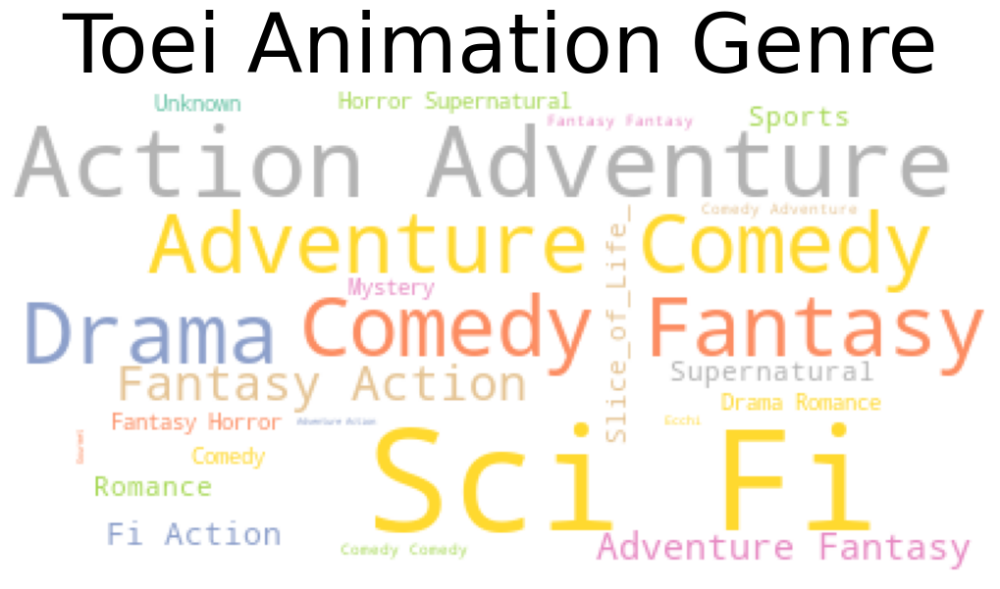

In [94]:
u_genre = ""
myanimelist.MAL_Genres[myanimelist.Studios == "Toei Animation"].unique()

for i in list(myanimelist.MAL_Genres[myanimelist.Studios == "Toei Animation"]) :
    j = [k.strip() for k in i.split(",")]
    for a in j :
        if len(a.split()) > 1 :
            s = ""
            for b in a.split() :
                s += b + "_"
            u_genre += s + " "
        else :
            u_genre += a + " "
wc = WordCloud(background_color ='white', colormap = "Set2").generate(u_genre)
plt.figure(figsize = (10, 10), facecolor = None)
plt.imshow(wc)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Toei Animation Genre", fontsize=60)
plt.show()


The word cloud below displays the most common genres that the movie type of anime uses in their anime. Sci Fi seems to be very prominent among movies!

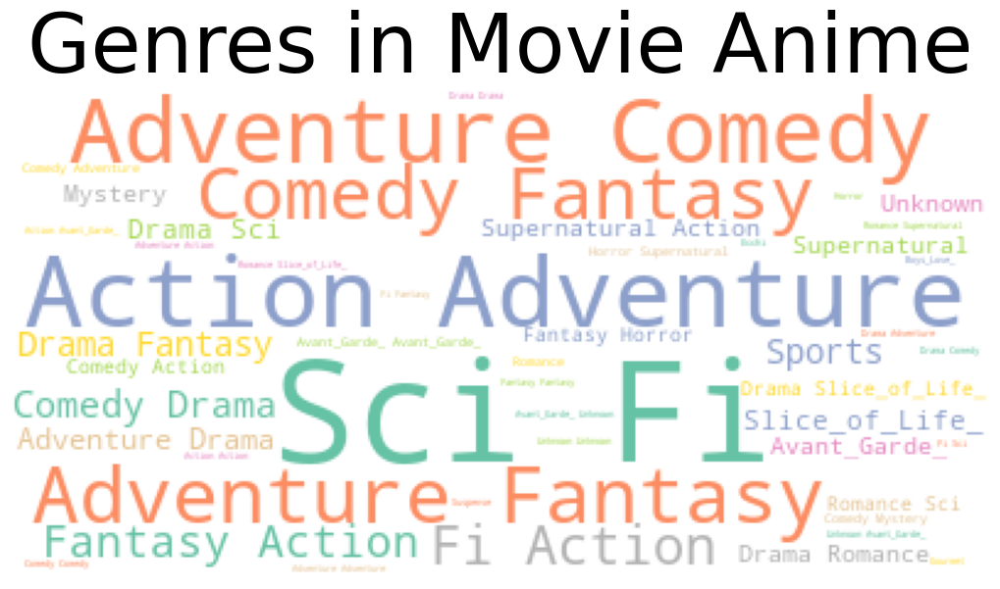

In [95]:
u_type = ""
myanimelist.MAL_Genres[myanimelist.Type == "Movie"].unique()

for i in list(myanimelist.MAL_Genres[myanimelist.Type == "Movie"]) :
    j = [k.strip() for k in i.split(",")]
    for a in j :
        if len(a.split()) > 1 :
            s = ""
            for b in a.split() :
                s += b + "_"
            u_genre += s + " "
        else :
            u_genre += a + " "
wc = WordCloud(background_color ='white', colormap = "Set2").generate(u_genre)
plt.figure(figsize = (10, 10), facecolor = None)
plt.imshow(wc)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Genres in Movie Anime", fontsize=60)
plt.show()

The word cloud below displays the most common genres for the MyAnimeList in general. Adventure, Comedy, Sci Fi, and Action Adventure are the biggest standouts. 

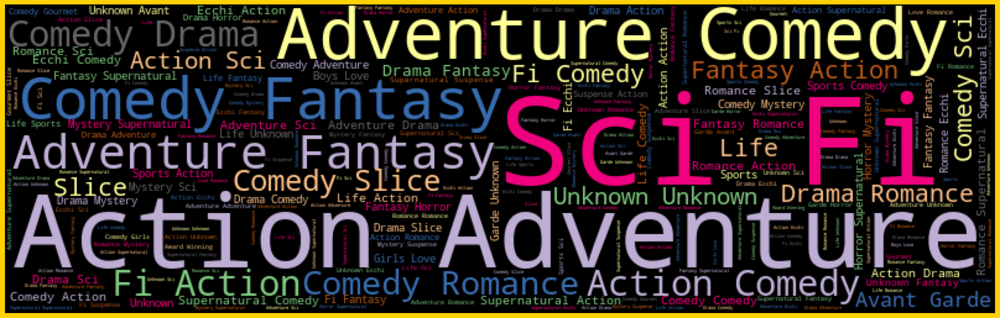

In [96]:
wordcloud = WordCloud(width = 800, height = 250, background_color ="black", colormap = 'Accent',
max_font_size=100, stopwords =None,repeat= True).generate(myanimelist["MAL_Genres"].str.cat(sep= ", | , | , "))
plt.figure(figsize = (20, 8),facecolor = "#ffd100")
plt.imshow(wordcloud)
plt.axis("off")
plt.margins(x = 0, y = 0)
plt.tight_layout(pad = 0)
plt.show()


## Final Results

Conclusion:

- Although these models could be used to predict the score of an anime due to the synopsis, they are not deemed to be optimal models with low reliability in accuracy, precision, and recall. The hypertuning performed and the unsupervised K-means modeling did not improve the models enough to perform them upon new data.

-  The exploratory analysis exposed interesting trends in the most commonly listed Studio, Source of the anime, Type of anime, as well as genres and themes. These can be used in marketing and improving the site for visitors.

-  A recommendation model was created in order to display the best next anime for someone who enjoyed the anime they inputted. It also helpfully has the score of the anime there for those who find importance in scores.




Recommendations:

- The most frequent words, especially the top 10 of 'source', 'one', 'world', 'write', 'mal', 'rewrite', 'school', 'girl',
'new', 'life' can be utilized to better understand that many anime are based in schools with a high number of girl characters. This can be used for marketing certain anime or to ensure that a synopsis will meet 

- There are many Nan and Null data and even 'unknown', it would be a good use of time to fill those in with meaningful information in order to perform a better analysis of the entire dataset. 

- The recommendation model created could be used to better ensure that the recommendations on MyAnimeList site are up to date and make sense according to the dataset and not just someone's opinion.

- Utilizing box office gross winnings could be implemented into MyAnimeList as they correlate with highly scored and highly grossed

Next Steps:

- I would like to combine this dataset with more data from other anime list and recommendation sites, such as Anime_Planet or Anilist. Since they do not allow web scraping, I would reach out for the information. 

-  I would like to look at the other information on MyAnimeList such as Manga, Manhua, and Manhwa (Japanese, Chinese, and Korean comics) to understand their patterns, modeling and make a recommendation system for them as well. 

-  I would utilize other hypertuned models after adding more data to model genres upon the synopses to predict the genres based on the synopses.
